## Setup

### Libraries

In [1]:
import numpy as np
import pandas as pd
import os
import anndata as ad
import scanpy as sc
import squidpy as sq

import seaborn as sns
from matplotlib import pyplot as plt
from matplotlib import rcParams
import matplotlib.colors as clr
from matplotlib.pyplot import rc_context
import glasbey

import gc
import scvi
import torch
from lightning.pytorch import seed_everything

c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\cupy\_environment.py:217: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\dask\dataframe\__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\numba\core\decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\anndata\utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
c

### Settings

Parallelization Settings:

In [2]:
torch.set_float32_matmul_precision('high')
torch.cuda.is_available()
seed_everything(12345)
sc.settings.n_jobs = 12

Seed set to 12345


Plot Settings:

In [3]:
GrBuPu = sns.blend_palette([sns.xkcd_rgb["light grey"],  sns.xkcd_rgb["light blue"], sns.xkcd_rgb["electric blue"], sns.xkcd_rgb['dark purple']], as_cmap=True)
GrSunSet = sns.blend_palette([sns.xkcd_rgb["light grey"], sns.xkcd_rgb["light orange"], sns.xkcd_rgb["red pink"], sns.xkcd_rgb['dark magenta']], as_cmap=True)
gray2blue = sns.blend_palette([sns.xkcd_rgb["light grey"], sns.xkcd_rgb["electric blue"]], as_cmap=True)

Stroma Markers

In [4]:
stroma_markers = {
    "Adipo": ["ADIPOQ", "LRP1", "THY1", "CD34", "CD44", "ICAM1", "CD90"],

    "Schwann": ["NRXN1", "MPZ"],
    "Neuron": ["CACNA1B", "NEFH", "SNAP25", "TAC1", "SLITRK6"],
    "Merkel": ["VIP", "KRT20", "CHGA", "PCP4"],

    "LEC": ["LYVE1", "ANGPT2", "CCL21"],
    "VEC": ["VWF", "FLT1", "KDR"],
    "HEC": ["ACKR1"],
    "Peri": ["ACTA2", "RGS5", "TCIM", "RGS16", "PDGFRB"],
    "SM": ["DES", "MCAM", "MYH11"],

    "Fib": ["PDGFRA", "COL1A1"],
    "Papil Fib": ["COMP", "COL18A1", "WIF1"],
    "Perivasc Fib": ["APOE", "CCL19", "PI16", "FN1", "CCDC80", "CXCL12"],
    "Retic Fib I/II": ["PRG4", "MMP2", "SFRP2"],  # PRG4+: Retic I; PRG4-: Retic II
    "Retic Fib III": ["THBS4", "CLU", "LUM", "ANGPTL7"],
    "Retic Fib IV": ["SFRP1", "APOD", "PTGDS", "TNNC1", "FOXD1", "TAGLN"],

    "DP": ["COCH", "CRABP1", "FIBIN", "PLXDC1"],
    "DS": ["ACAN", "COL11A1", "DPEP1", "LRRC15", "MYL4", "TNN", "ITGA8"]
}

### Functions

Filter a set of marker genes by what's detectred in the matrix

In [5]:
def filter_markers_by_genes(marker_dict, detected_genes):
    """
    Filters each cell type's marker list to only include genes detected in the expression matrix.

    Args:
        marker_dict (dict): Dictionary of cell type → list of marker genes.
        detected_genes (iterable): List or set of gene names detected in expression matrix.

    Returns:
        dict: Filtered marker dictionary.
    """
    detected_genes_set = set(detected_genes)
    filtered_dict = {
        cell_type: [gene for gene in markers if gene in detected_genes_set]
        for cell_type, markers in marker_dict.items()
    }
    return filtered_dict

Cluster Marker Calculation Function:

In [6]:
def compute_markers_for_resolution(adata, res, prefix, output_dir):
    print(f"Processing resolution: {res}")
    
    # Make a copy to avoid parallel conflicts
    ad = adata.copy()

    # Assign cluster
    ad.obs["cluster"] = ad.obs[res]

    # Run marker test
    sc.tl.rank_genes_groups(
        ad,
        groupby="cluster",
        method="wilcoxon",
        layer="log1p",
        use_raw=False,
        pts=True
    )

    # Extract markers
    marker_df = sc.get.rank_genes_groups_df(ad, group=None)
    marker_df = marker_df.rename(columns={'group': 'cluster',  "names": "gene",  "logfoldchanges": "log2fc",
                                          'pvals': 'pval', "pvals_adj": "padj",  'pct_nz_group': 'pct_cluster', 'pct_nz_reference': 'pct_reference'})
    
    marker_df['diff_pct'] = marker_df['pct_cluster'] - marker_df['pct_reference']
    marker_df["resolution"] = res
    marker_df["is_signif"] = marker_df["padj"] < 0.05
    marker_df["is_positive"] = marker_df["log2fc"] > 0

    # marker_df = marker_df.sort_values(by=["cluster", "log2fc", 'padj', 'diff_pct'], ascending=[True, False, True, False])


    # Save significant markers to CSV
    sig_df = marker_df[marker_df["is_signif"]&marker_df["is_positive"]].copy()
    out_csv = os.path.join(output_dir, f"{prefix}.reclustered.{res}.scanpy.cluster_markers.csv")
    sig_df.to_csv(out_csv, index=False)

    return marker_df
    
def calculate_cluster_markers(
        adata,
        prefix,
        res_cols,
        data_path
):
    output_dir = os.path.join(data_path, "cluster_markers")
    os.makedirs(output_dir, exist_ok=True)

    # Run in parallel
    cluster_marker_list = {}
    for res in res_cols:
        cluster_marker_list[res] = compute_markers_for_resolution(adata,res, prefix, output_dir)
        print(f"Finished processing resolution: {res}")
        gc.collect()
    
    return cluster_marker_list

## Main Stroma Reclustering

In [9]:
reclust_category = "Stroma"

In [29]:
adata = sc.read_h5ad("../../data/merfish/BAYSOR/seurat_objects/ns-atlas.merfish_baysor.scvi_integrated.anndata.h5ad")
global_metadf = adata.obs.copy()

In [30]:
filt = [x == reclust_category for x in adata.obs['cell_category']]
adata = sc.AnnData(X=adata[filt].layers['counts'], obs=adata[filt].obs, var=adata[filt].var)
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.layers['log1p'] = adata.X.copy()
sc.pp.highly_variable_genes(adata, n_top_genes=500, batch_key = 'sample_barcode', subset=False)
sc.pp.scale(adata, max_value=10)
adata.layers['scaled'] = adata.X.copy()
gc.collect()

32529

### SCVI Integration

In [31]:
adata_filt = adata[:, adata.var['in_both_panels']].copy()
scvi.model.SCVI.setup_anndata(adata_filt, layer="counts", batch_key="sample_barcode", continuous_covariate_keys=["transcript_count"], categorical_covariate_keys=['collection_source'])
train_kwargs = {"train_size": 1.0}
model = scvi.model.SCVI(adata_filt, n_layers=2, n_latent=30, gene_likelihood="nb")
model.train(accelerator='gpu', **train_kwargs)
model.save(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}_scvi_model', overwrite=True)
del adata_filt
gc.collect()

c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scvi\model\_scvi.py:159: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  library_log_means, library_log_vars = _init_library_size(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Epoch 14/14: 100%|██████████| 14/14 [08:02<00:00, 34.24s/it, v_num=1, train_loss_step=66.8, train_loss_epoch=64.3]

`Trainer.fit` stopped: `max_epochs=14` reached.


Epoch 14/14: 100%|██████████| 14/14 [08:02<00:00, 34.45s/it, v_num=1, train_loss_step=66.8, train_loss_epoch=64.3]


105

In [32]:
adata.obsm[f'reclust_scvi'] = model.get_latent_representation()
sc.pp.neighbors(adata, use_rep = f'reclust_scvi', n_neighbors=30, n_pcs=30, random_state=12345)
sc.tl.umap(adata, min_dist=0.1, negative_sample_rate=10, key_added='reclust_scvi_umap', random_state=12345)

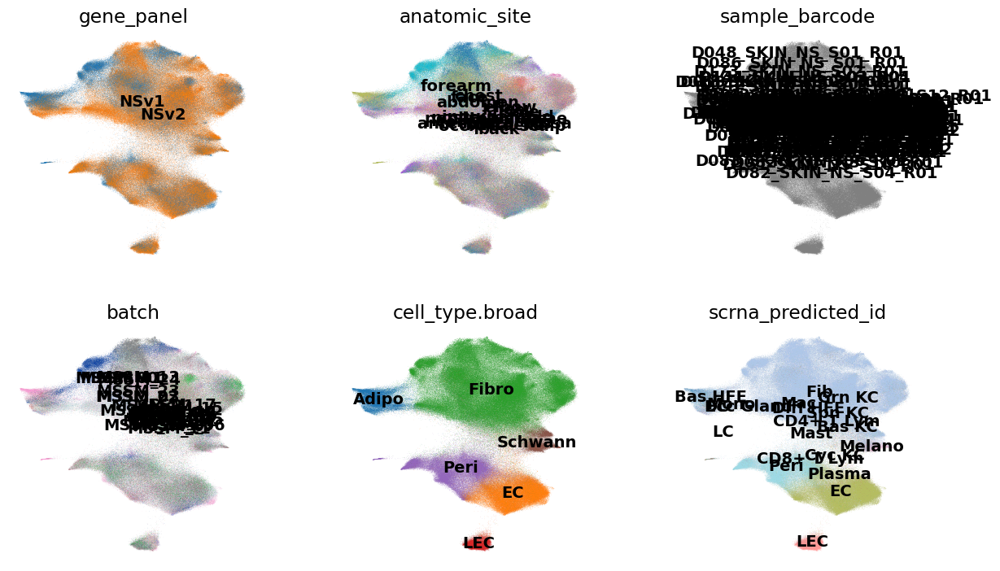

In [47]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(adata, basis='reclust_scvi_umap', color=['gene_panel', 'anatomic_site', 'sample_barcode', 'batch', 'cell_type.broad', 'scrna_predicted_id'],
                     frameon=False, ncols=3, legend_loc='on data')

In [35]:
resolutions = [0.2, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 2.5]
for res in resolutions:
    sc.tl.leiden(adata, resolution = res, key_added=f'reclust.scvi.leiden_{res}', random_state=12345, n_iterations=10)
    print(adata.obs[f'reclust.scvi.leiden_{res}'].value_counts())

C:\Users\Paula\AppData\Local\Temp\ipykernel_21988\858482250.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = res, key_added=f'reclust.scvi.leiden_{res}', random_state=12345, n_iterations=10)


reclust.scvi.leiden_0.2
0    363070
1    187753
2     33903
3       975
Name: count, dtype: int64
reclust.scvi.leiden_0.4
0    261126
1    173394
2     98564
3     34903
4     16723
5       991
Name: count, dtype: int64
reclust.scvi.leiden_0.5
0    190816
1    159809
2    126449
3     42063
4     35762
5     16908
6     13894
Name: count, dtype: int64
reclust.scvi.leiden_0.6
0    157554
1    107865
2     91898
3     81643
4     47792
5     45092
6     35836
7     17027
8       994
Name: count, dtype: int64
reclust.scvi.leiden_0.8
0     101563
1      88976
2      83831
3      76030
4      69297
5      47953
6      41891
7      38449
8      19286
9      17420
10      1005
Name: count, dtype: int64
reclust.scvi.leiden_1
0     85770
1     77318
2     71035
3     67650
4     51564
5     47930
6     41259
7     40163
8     39749
9     25388
10    20209
11    17666
Name: count, dtype: int64
reclust.scvi.leiden_1.5
0     75947
1     67131
2     45966
3     45320
4     44305
5     42152
6     4

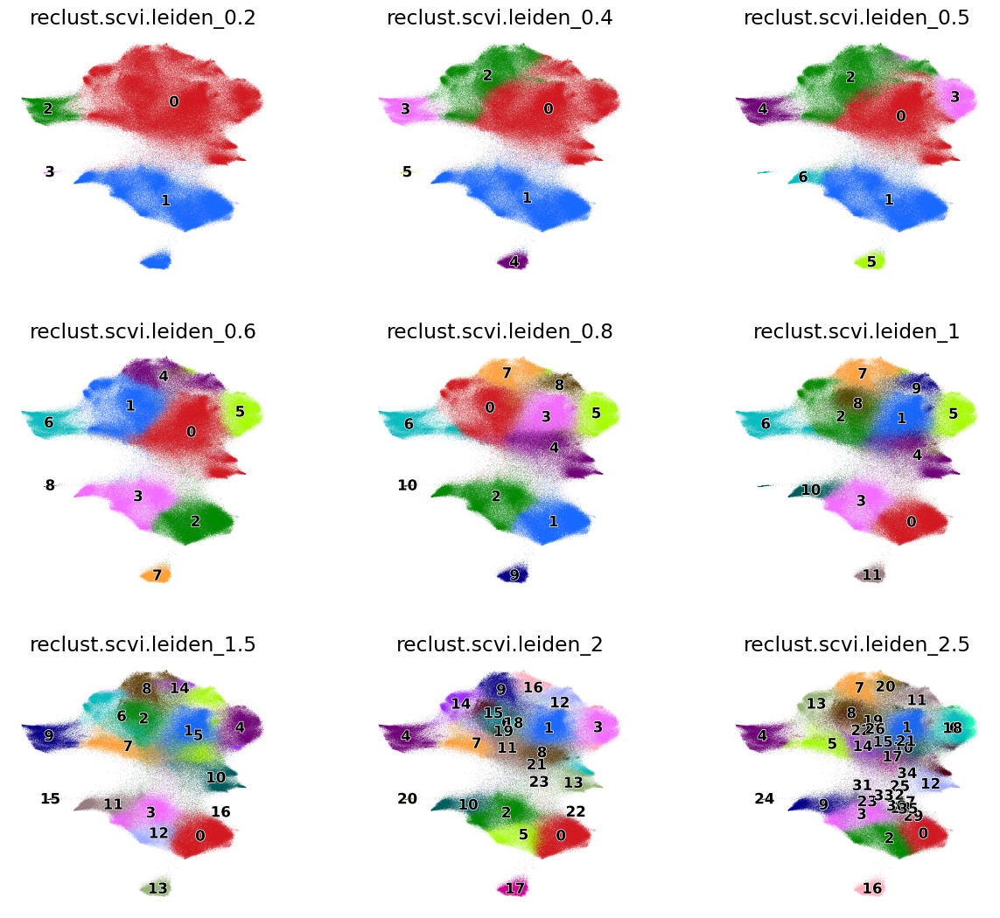

In [36]:
res_cols = [f'reclust.scvi.leiden_{res}' for res in resolutions]
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(adata, basis=f'reclust_scvi_umap', color=res_cols, frameon=False, ncols=3, 
                    legend_loc='on data', palette=glasbey.create_palette(40), legend_fontoutline=1, legend_fontsize=12)

In [37]:
adata.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')

### Harmony Integration

In [7]:
adata = sc.read_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad')

In [8]:
import scanpy.external as sce
sc.tl.pca(adata, n_comps=30, mask_var='in_both_panels', key_added='pca')
sce.pp.harmony_integrate(adata, key='sample_barcode', basis='pca', adjusted_basis='reclust_harmony')
sc.pp.neighbors(adata, use_rep = f'reclust_harmony', n_pcs=30, n_neighbors=30, random_state=12345)
sc.tl.umap(adata, min_dist=0.1, negative_sample_rate=10, key_added=f'reclust_harmony_umap', random_state=12345)

resolutions = [0.2, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 2.5]
for res in resolutions:
    sc.tl.leiden(adata, resolution = res, key_added=f'reclust.harmony.leiden_{res}', random_state=12345)
    print(adata.obs[f'reclust.harmony.leiden_{res}'].value_counts())
adata.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')
adata.obs.to_csv(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.cell_metadata.csv')

2025-04-18 13:25:55,138 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-18 13:26:24,472 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-18 13:26:26,826 - harmonypy - INFO - Iteration 1 of 10
2025-04-18 13:31:21,374 - harmonypy - INFO - Iteration 2 of 10
2025-04-18 13:36:15,183 - harmonypy - INFO - Iteration 3 of 10
2025-04-18 13:41:58,726 - harmonypy - INFO - Iteration 4 of 10
2025-04-18 13:46:24,817 - harmonypy - INFO - Iteration 5 of 10
2025-04-18 13:50:17,936 - harmonypy - INFO - Iteration 6 of 10
2025-04-18 13:53:36,832 - harmonypy - INFO - Iteration 7 of 10
2025-04-18 13:56:30,977 - harmonypy - INFO - Iteration 8 of 10
2025-04-18 13:59:11,708 - harmonypy - INFO - Iteration 9 of 10
2025-04-18 14:01:45,779 - harmonypy - INFO - Iteration 10 of 10
2025-04-18 14:04:07,834 - harmonypy - INFO - Stopped before convergence
C:\Users\Paula\AppData\Local\Temp\ipykernel_24756\2127216559.py:9: FutureWarning: In the future, the default backend

reclust.harmony.leiden_0.2
0    345558
1    153377
2     35268
3     19007
4     16538
5     15953
Name: count, dtype: int64
reclust.harmony.leiden_0.4
0    112517
1    104058
2     98527
3     95158
4     52925
5     35407
6     31250
7     20639
8     19296
9     15924
Name: count, dtype: int64
reclust.harmony.leiden_0.5
0     115049
1      98639
2      95774
3      59739
4      53472
5      36703
6      35593
7      31707
8      21555
9      19313
10     18157
Name: count, dtype: int64
reclust.harmony.leiden_0.6
0     113189
1      95101
2      92231
3      61032
4      53854
5      38290
6      35737
7      31968
8      22188
9      19345
10     18267
11      4499
Name: count, dtype: int64
reclust.harmony.leiden_0.8
0     93892
1     89093
2     65368
3     54304
4     48110
5     39042
6     38591
7     35639
8     32473
9     23000
10    19338
11    17033
12    16009
13    11394
14     2415
Name: count, dtype: int64
reclust.harmony.leiden_1
0     82642
1     61852
2     52451
3  

In [15]:
resolutions = [0.2, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 2.5]
for res in resolutions:
    sc.tl.leiden(adata, resolution = res, key_added=f'reclust.harmony.leiden_{res}', random_state=12345)
    print(adata.obs[f'reclust.harmony.leiden_{res}'].value_counts())
adata.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')
adata.obs.to_csv(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.cell_metadata.csv')

C:\Users\Paula\AppData\Local\Temp\ipykernel_9400\3140578405.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = res, key_added=f'reclust.harmony.leiden_{res}', random_state=12345)


reclust.harmony.leiden_0.2
0    345546
1    153377
2     35280
3     19007
4     16538
5     15953
Name: count, dtype: int64
reclust.harmony.leiden_0.4
0    112504
1    104010
2     98703
3     95190
4     52783
5     35404
6     31264
7     20625
8     19297
9     15921
Name: count, dtype: int64
reclust.harmony.leiden_0.5
0     114928
1      98823
2      95839
3      59528
4      53402
5      36785
6      35562
7      31721
8      21644
9      19311
10     18158
Name: count, dtype: int64
reclust.harmony.leiden_0.6
0     112665
1      95072
2      92723
3      61127
4      53904
5      38262
6      35721
7      32021
8      22189
9      19346
10     18243
11      4428
Name: count, dtype: int64
reclust.harmony.leiden_0.8
0     93902
1     89646
2     65337
3     54317
4     48150
5     39058
6     38404
7     35649
8     32359
9     22999
10    19338
11    17032
12    16006
13    11091
14     2413
Name: count, dtype: int64
reclust.harmony.leiden_1
0     82951
1     61754
2     52452
3  

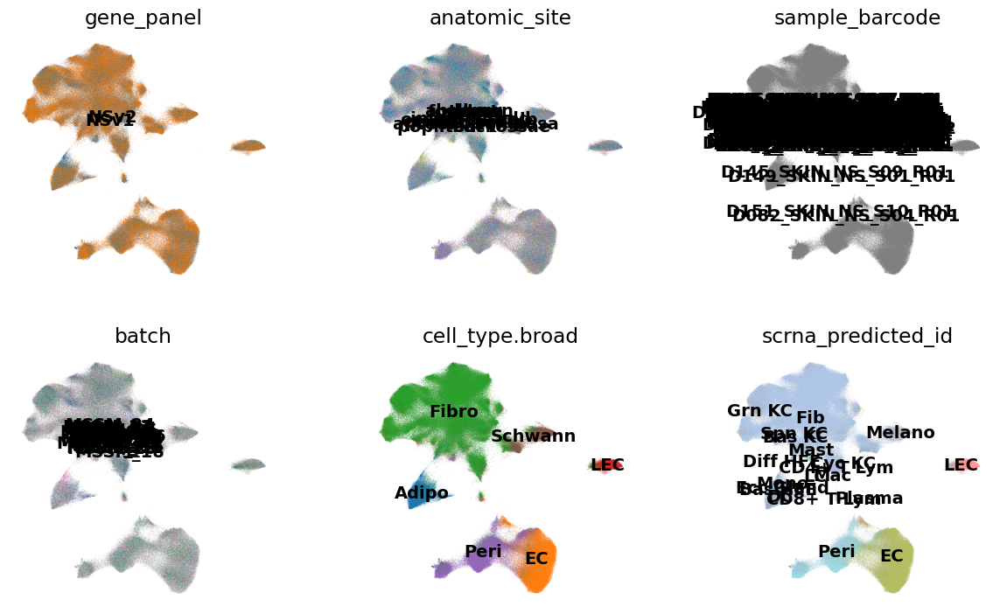

In [17]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(adata, basis='reclust_harmony_umap', color=['gene_panel', 'anatomic_site', 'sample_barcode', 'batch', 'cell_type.broad', 'scrna_predicted_id'],
                     frameon=False, ncols=3, legend_loc='on data')

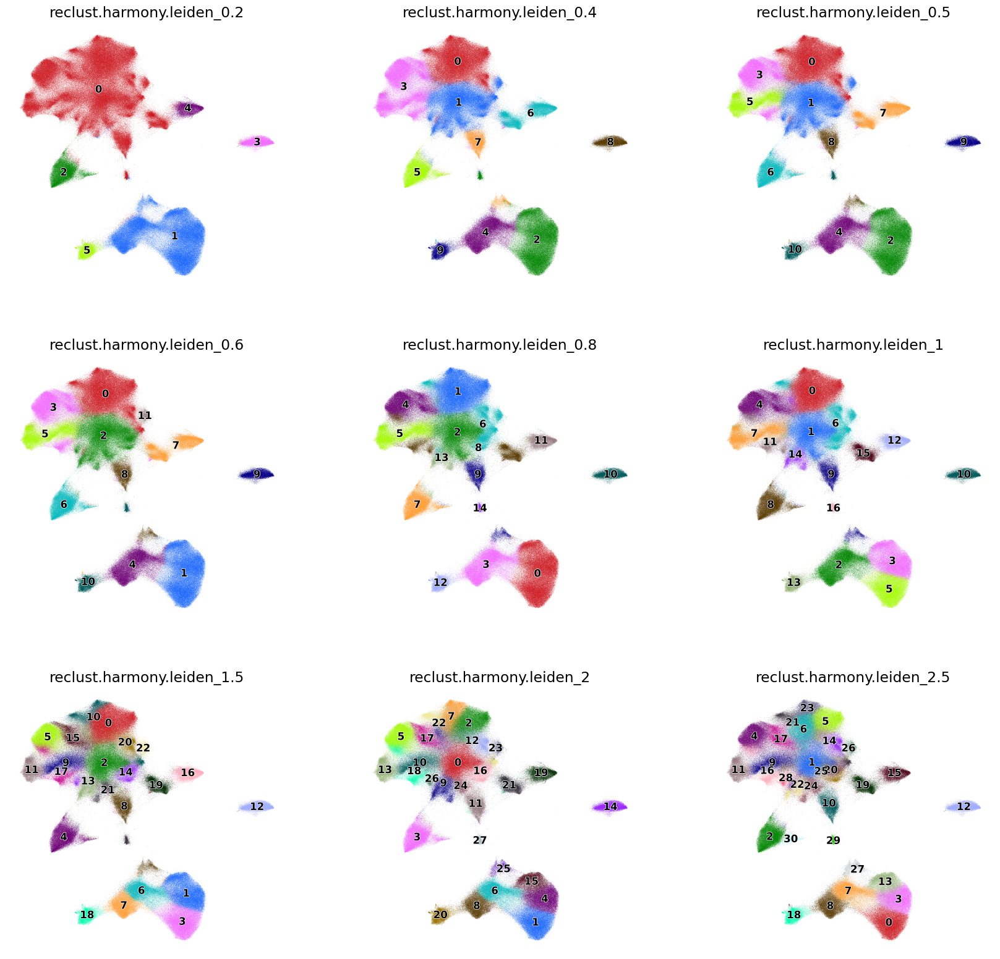

In [18]:
res_cols = [f'reclust.harmony.leiden_{res}' for res in resolutions]
with rc_context({"figure.figsize": (6, 6), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(adata, basis=f'reclust_harmony_umap', color=res_cols, frameon=False, ncols=3, 
                    legend_loc='on data', palette=glasbey.create_palette(40), legend_fontoutline=1, legend_fontsize=12)

### scRNA Prediction

In [39]:
scanvi_query = scvi.model.SCANVI.load_query_data(adata, f'../../data/scrna/{reclust_category}_scanvi_reference_model')
scanvi_query.train(accelerator='gpu', max_epochs=10)

INFO     File ../../data/scrna/Stroma_scanvi_reference_model\model.pt already downloaded                           
INFO     Training for 10 epochs.                                                                                   


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Epoch 10/10: 100%|██████████| 10/10 [07:52<00:00, 46.99s/it, v_num=1, train_loss_step=85.4, train_loss_epoch=91.2]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 10/10: 100%|██████████| 10/10 [07:52<00:00, 47.21s/it, v_num=1, train_loss_step=85.4, train_loss_epoch=91.2]


In [40]:
SCANVI_PREDICTIONS_KEY = f'category.scrna_predicted_id'
adata.obsm["scrna_scanvi"] = scanvi_query.get_latent_representation()
adata.obs[SCANVI_PREDICTIONS_KEY] = scanvi_query.predict()

In [42]:
adata.obs['corrected_predicted_id'] = adata.obs['category.scrna_predicted_id'].copy()
adata.obs['corrected_predicted_id'] = adata.obs['category.scrna_predicted_id'].values.astype('str').tolist().copy()
adata.obs.loc[adata.obs['cell_type.broad'] == 'Adipo', 'corrected_predicted_id'] = 'Adipo'
adata.obs['corrected_predicted_id'] = adata.obs['corrected_predicted_id'].astype('category')

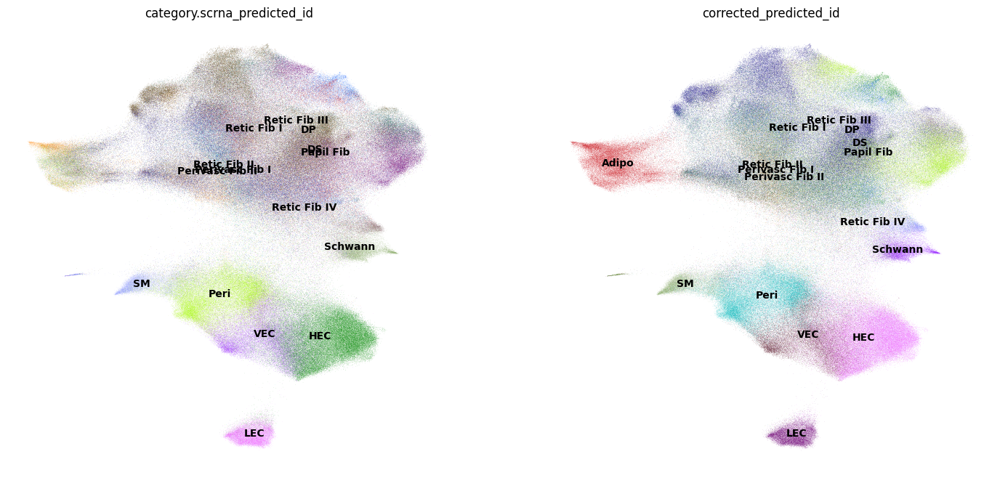

In [32]:
with rc_context({"figure.figsize": (8, 8), "image.aspect": 1}):
    sc.pl.embedding(adata, basis='reclust_scvi_umap', color=['category.scrna_predicted_id', 'corrected_predicted_id'], legend_loc='on data', ncols=2, frameon=False, 
                    palette=glasbey.create_palette(len(adata.obs['corrected_predicted_id'].cat.categories)))

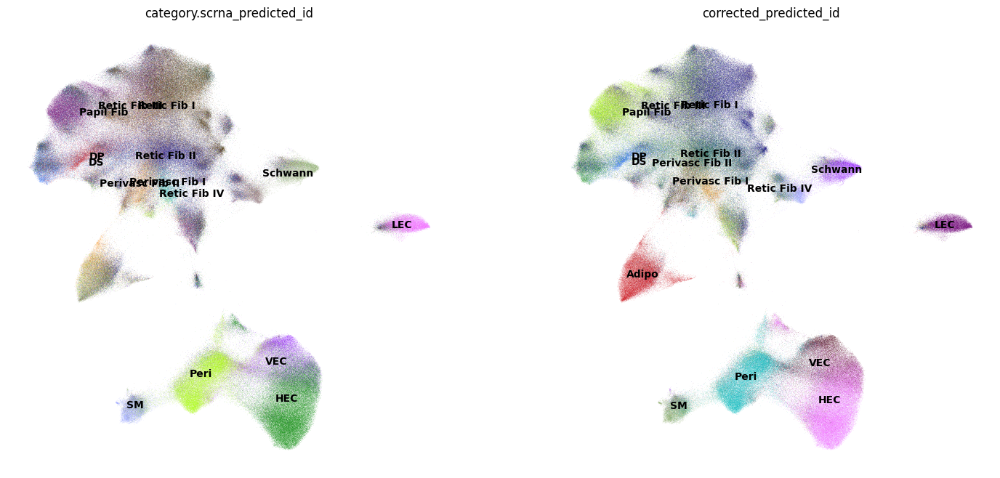

In [34]:
with rc_context({"figure.figsize": (8, 8), "image.aspect": 1}):
    sc.pl.embedding(adata, basis='reclust_harmony_umap', color=['category.scrna_predicted_id', 'corrected_predicted_id'], legend_loc='on data', ncols=2, frameon=False, 
                    palette=glasbey.create_palette(len(adata.obs['corrected_predicted_id'].cat.categories)))

In [12]:
adata.obsm['X_umap'] = adata.obsm['reclust_harmony_umap']

In [13]:
sc.tl.embedding_density(adata, basis='umap', key_added='umap_density.category.scrna_predicted_id', groupby='category.scrna_predicted_id')
sc.tl.embedding_density(adata, basis='umap', key_added='umap_density.corrected_predicted_id', groupby='corrected_predicted_id')
sc.tl.embedding_density(adata, basis='umap', key_added='umap_density.anatomic_site', groupby='anatomic_site')

In [36]:
sc.tl.embedding_density(adata, basis='umap', key_added='umap_density.corrected_predicted_id', groupby='corrected_predicted_id')

In [14]:
adata.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')
adata.obs.to_csv(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.cell_metadata.csv')

C:\Users\Paula\AppData\Local\Temp\ipykernel_24756\3408541979.py:3: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


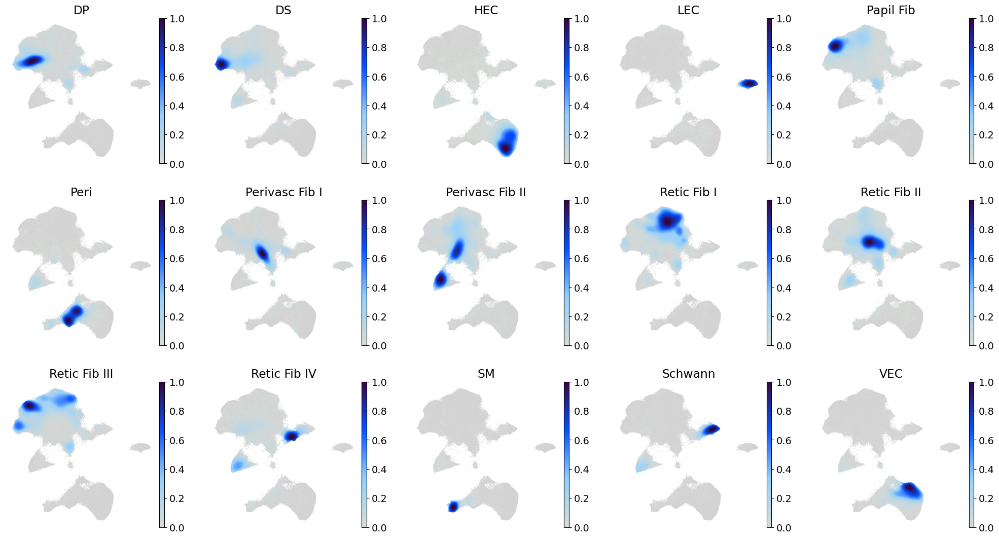

In [16]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding_density(adata, basis='umap', key='umap_density.category.scrna_predicted_id', color_map=GrBuPu, bg_dotsize=1, fg_dotsize=5, ncols=5, frameon=False, show=False)
    plt.tight_layout()
    plt.show()
    plt.close()


C:\Users\Paula\AppData\Local\Temp\ipykernel_24756\2075145019.py:3: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


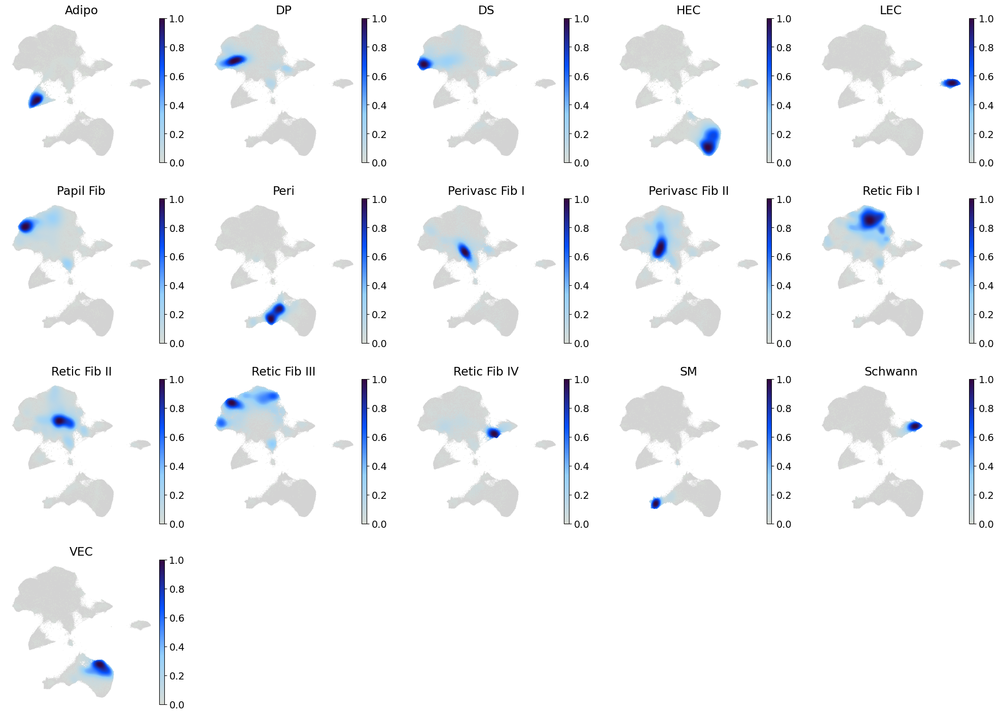

In [37]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding_density(adata, basis='umap', key='umap_density.corrected_predicted_id', color_map=GrBuPu, bg_dotsize=1, fg_dotsize=5, ncols=5, frameon=False, show=False)
    plt.tight_layout()
    plt.show()
    plt.close()

C:\Users\Paula\AppData\Local\Temp\ipykernel_24756\358804309.py:3: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


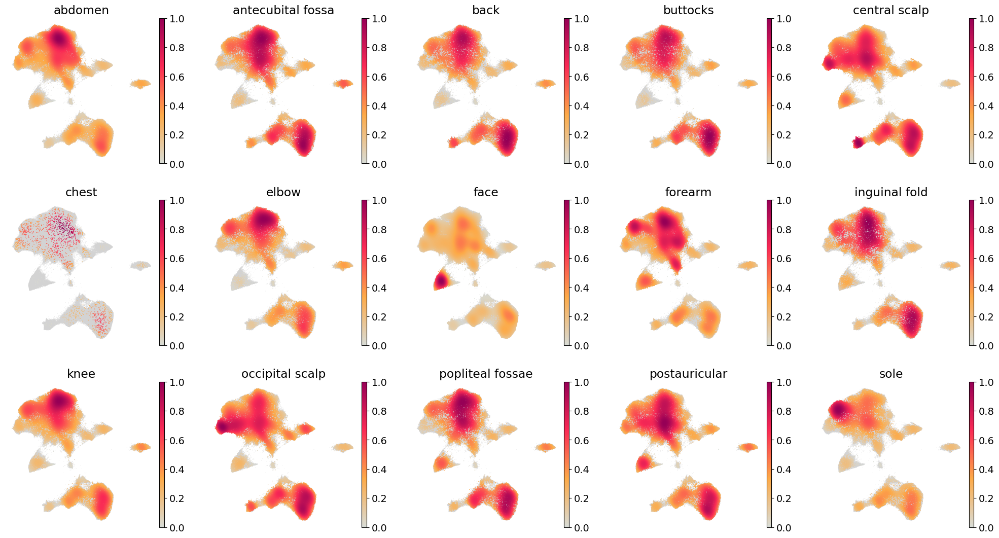

In [17]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding_density(adata, basis='umap', key='umap_density.anatomic_site', color_map=GrSunSet, bg_dotsize=1, fg_dotsize=5, ncols=5, frameon=False, show=False)
    plt.tight_layout()
    plt.show()
    plt.close()



### Stroma Plots

In [10]:
adata = sc.read_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad')

In [15]:
stroma_markers = filter_markers_by_genes(stroma_markers, adata.var_names)

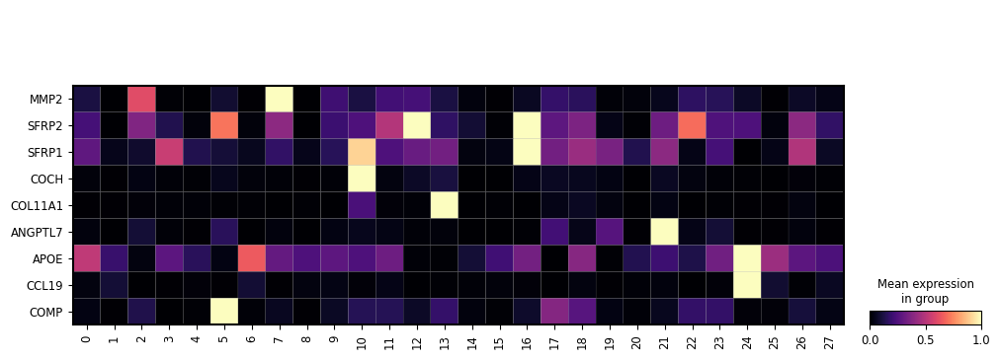

In [72]:
with plt.rc_context({}): 
    sc.pl.matrixplot(adata, ['MMP2', 'SFRP2', "SFRP1", 'COCH', 'COL11A1', 'ANGPTL7', 'APOE', 'CCL19', 'COMP'], groupby='reclust.harmony.leiden_2',cmap='magma',  standard_scale='var', swap_axes=True)
    plt.show()
    plt.close()

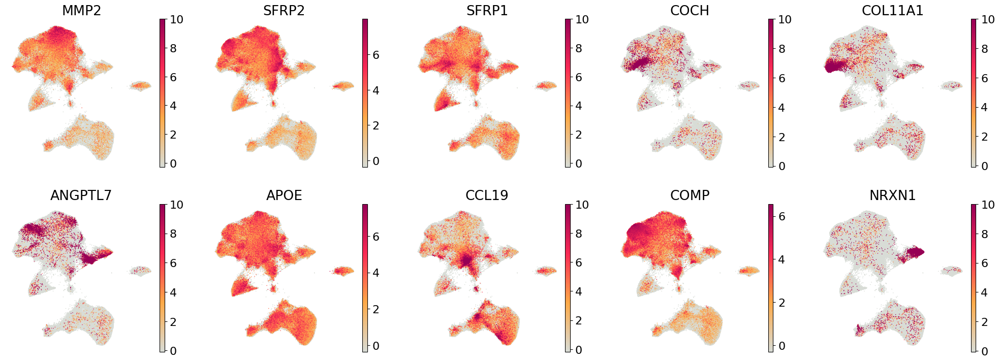

In [54]:
with plt.rc_context({"figure.figsize": (4, 4), "font.size": 16, "image.aspect": 1}): 
    sc.pl.embedding(adata, basis=f'reclust_harmony_umap', color=['MMP2', 'SFRP2', "SFRP1", 'COCH', 'COL11A1', 'ANGPTL7', 'APOE', 'CCL19', 'COMP', 'NRXN1'],ncols=5, cmap=GrSunSet, frameon=False, show=False, size=5)
    plt.show()
    plt.close()

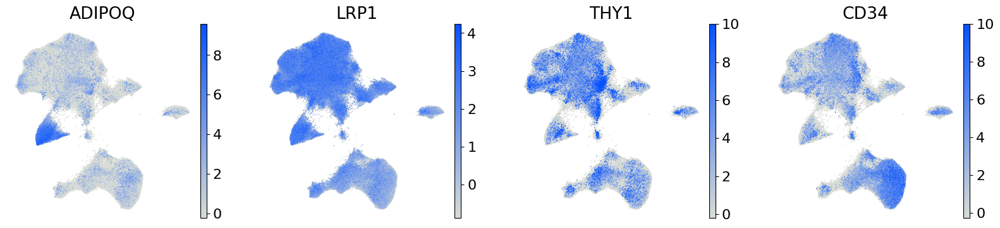

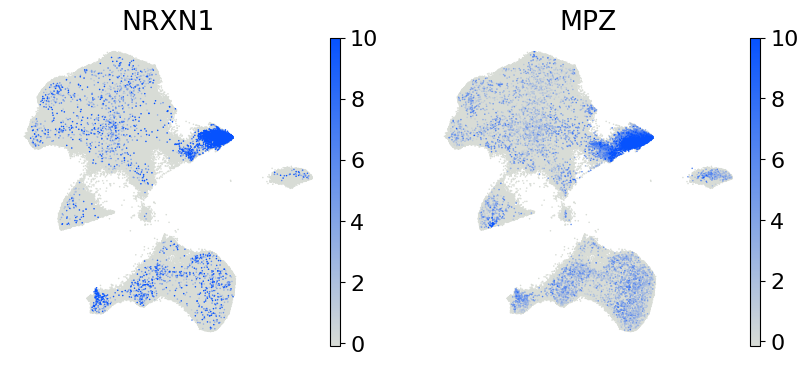

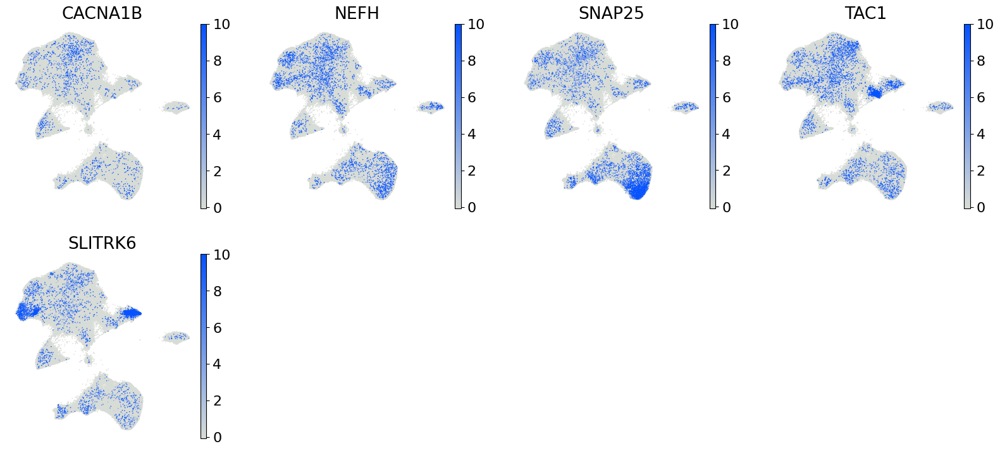

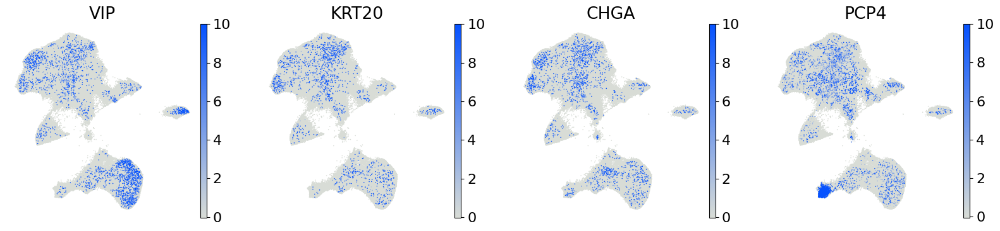

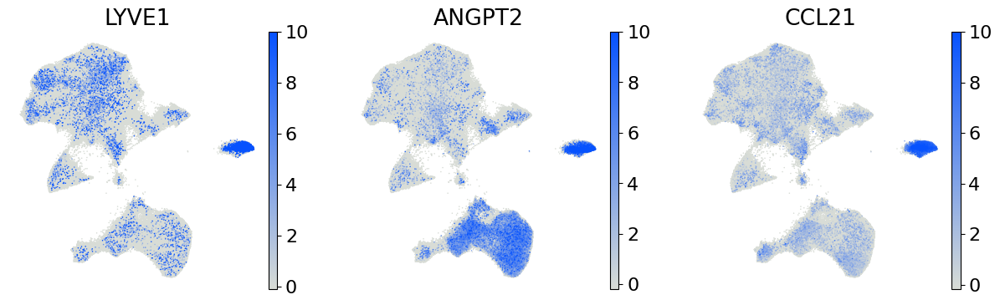

...

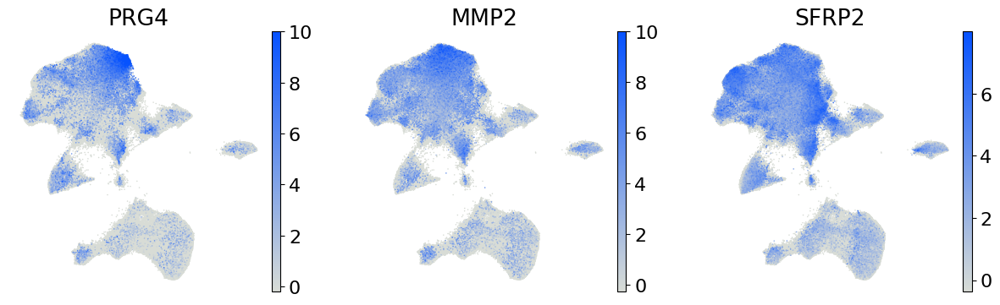

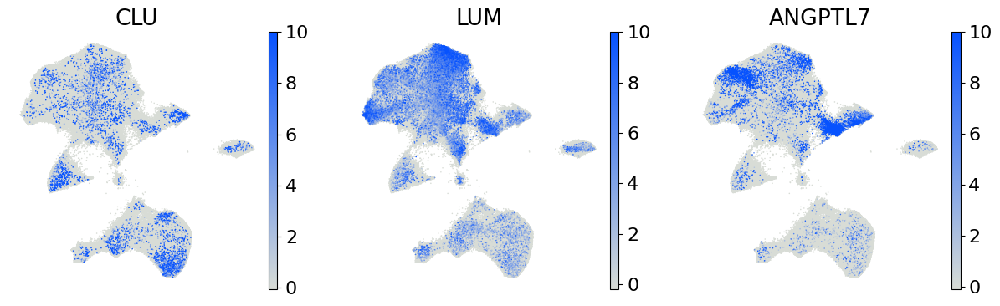

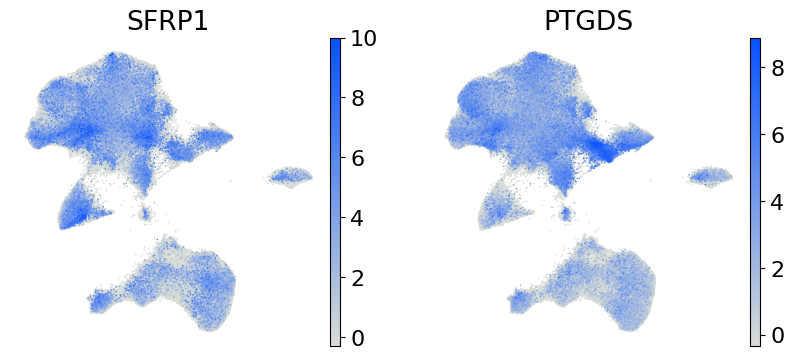

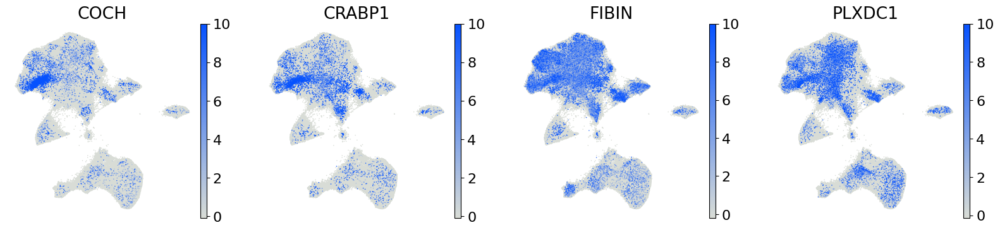

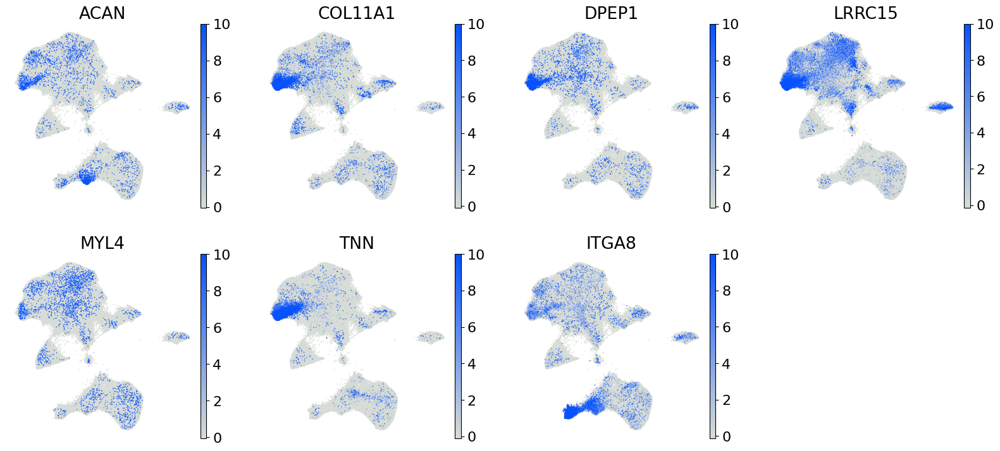

In [13]:
for cell_type in stroma_markers.keys():
    with rc_context({"figure.figsize": (4, 4), "font.size": 16, "image.aspect": 1}):
        sc.pl.embedding(adata, basis='reclust_harmony_umap', color=stroma_markers[cell_type],size=5, cmap=gray2blue, frameon=False, show=False)
        cell_type = cell_type.replace(" ", "_").replace("+", "_pos").replace("-", "_").replace("/", "_")
        plt.savefig(f'D:/Dropbox/_projects/NormalSkinAtlas/figures/merfish/BAYSOR/reclustering/{reclust_category}/feature_umap/{reclust_category}.{cell_type}.markers.harmony_feature_umap.png', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

In [14]:
for res_col in res_cols:
   with plt.rc_context({"font.size": 14}): 
        dp = sc.pl.dotplot(adata, var_names = stroma_markers,
                           groupby=res, dendrogram=False,
                           cmap=gray2blue, show=False,
                           standard_scale='var', layer='log1p',
                           dot_min=0.05, dot_max=0.75,
                           colorbar_title='Avg Expr', 
                           size_title='Pct Expr (%)')
        ax = dp['mainplot_ax']
        ax.set_xlabel('Stroma Markers', fontweight='bold')
        ax.set_ylabel(res, fontweight='bold')
        plt.savefig(f'D:/Dropbox/_projects/NormalSkinAtlas/figures/merfish/BAYSOR/reclustering/{reclust_category}/dot_plots/{reclust_category}.{res_col}.stroma_markers.dotplot.png', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

NameError: name 'res_cols' is not defined

### Stroma Cluster Markers

In [88]:
stroma_cluster_markers = calculate_cluster_markers(adata, prefix=reclust_category, res_cols=res_cols, data_path=f'../../data/merfish/BAYSOR/reclustering/{reclust_category}')

Processing resolution: reclust.harmony.leiden_0.2
Finished processing resolution: reclust.harmony.leiden_0.2
Processing resolution: reclust.harmony.leiden_0.4
Finished processing resolution: reclust.harmony.leiden_0.4
Processing resolution: reclust.harmony.leiden_0.5
Finished processing resolution: reclust.harmony.leiden_0.5
Processing resolution: reclust.harmony.leiden_0.6
Finished processing resolution: reclust.harmony.leiden_0.6
Processing resolution: reclust.harmony.leiden_0.8
Finished processing resolution: reclust.harmony.leiden_0.8
Processing resolution: reclust.harmony.leiden_1
Finished processing resolution: reclust.harmony.leiden_1
Processing resolution: reclust.harmony.leiden_1.5


c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:440: PerformanceWarning: DataFrame i

Finished processing resolution: reclust.harmony.leiden_1.5
Processing resolution: reclust.harmony.leiden_2


c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:440: PerformanceWarning: DataFrame i

Finished processing resolution: reclust.harmony.leiden_2
Processing resolution: reclust.harmony.leiden_2.5


c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:440: PerformanceWarning: DataFrame i

Finished processing resolution: reclust.harmony.leiden_2.5


C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


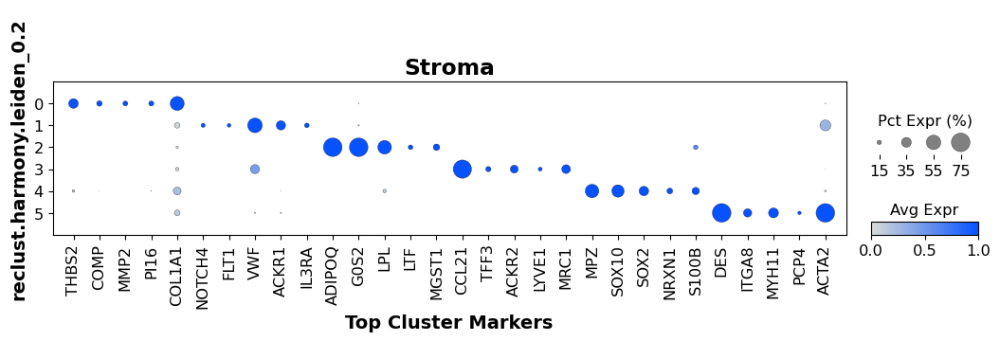

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


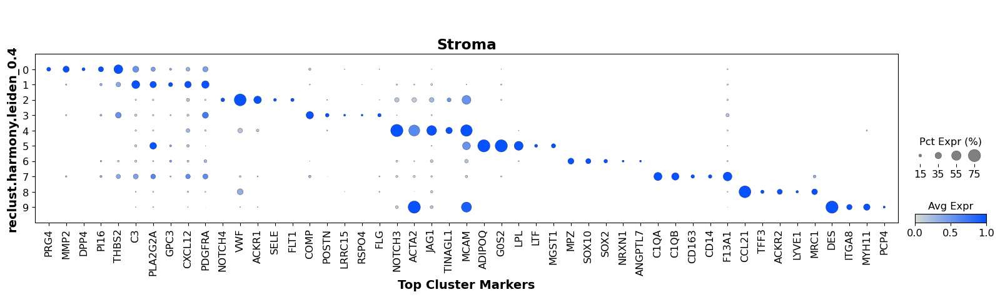

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


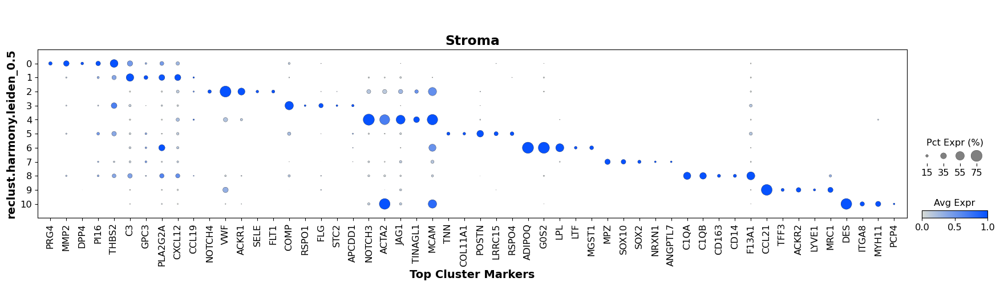

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


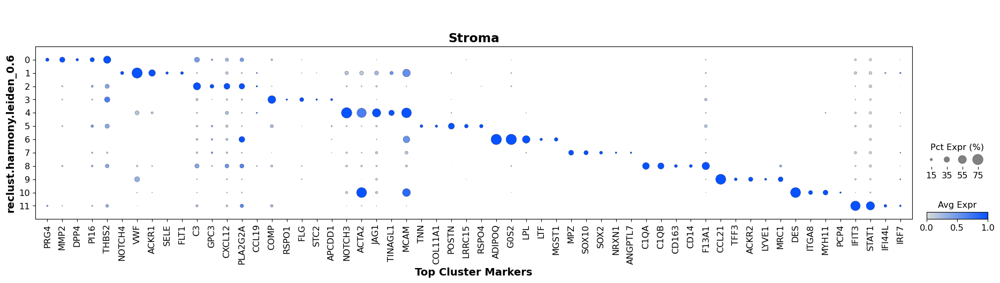

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


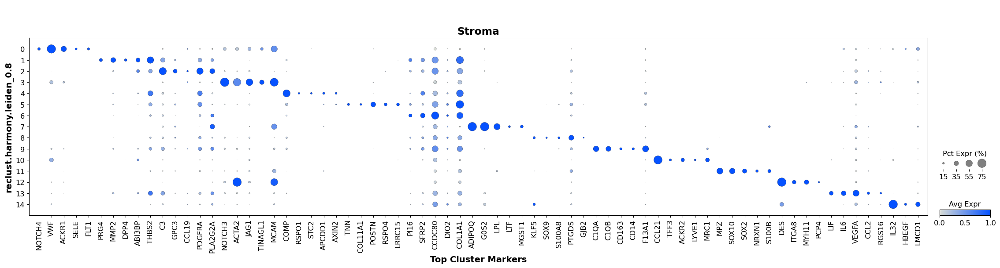

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


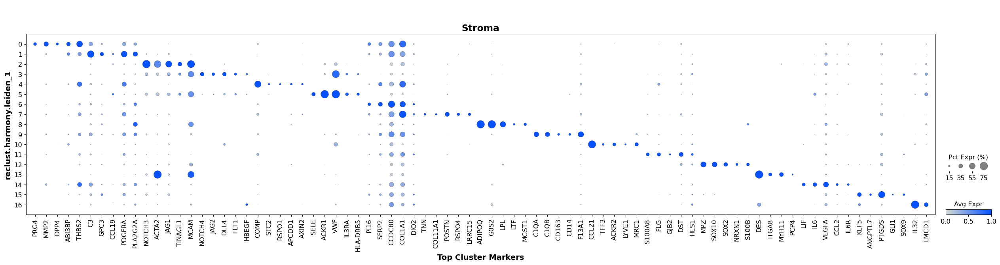

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


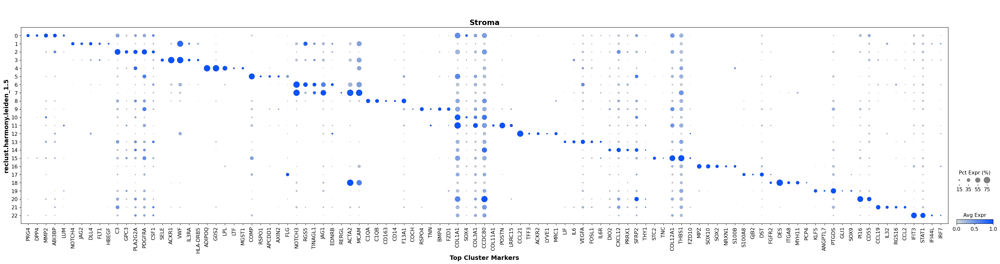

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


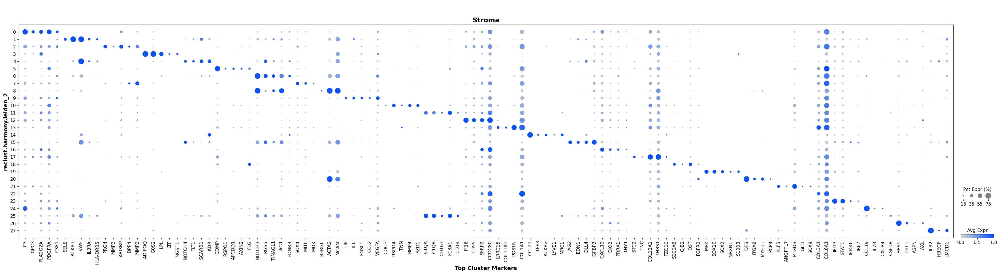

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2582753182.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)


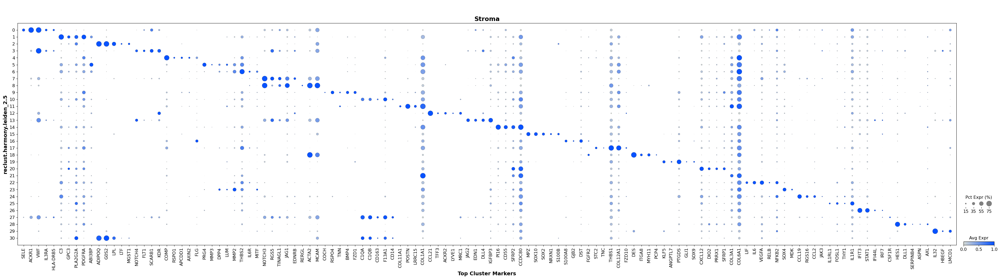

In [89]:
for res in res_cols:
    top_markers = stroma_cluster_markers[res][stroma_cluster_markers[res]["is_signif"]&stroma_cluster_markers[res]["is_positive"]]
    top_markers['cluster'] = top_markers['cluster'].astype('int64')
    if len(top_markers)>1:
        top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(5, 'log2fc')['gene'].values)
        top_markers = top_markers.explode().dropna().unique().tolist()
        with plt.rc_context({"font.size": 14}): 
            dp = sc.pl.dotplot(adata, var_names = top_markers,
                          groupby=res, dendrogram=False,
                          cmap=gray2blue, show=False,
                          standard_scale='var', layer='log1p',
                          dot_min=0.05, dot_max=0.75,
                          colorbar_title='Avg Expr', 
                          size_title='Pct Expr (%)')
            ax = dp['mainplot_ax']
            ax.set_xlabel('Top Cluster Markers', fontweight='bold')
            ax.set_ylabel(res, fontweight='bold')
            ax.set_title(f'{reclust_category}', fontweight='bold')
            # Save the figure
            plt.savefig(f'D:/Dropbox/_projects/NormalSkinAtlas/figures/merfish/BAYSOR/reclustering/{reclust_category}/dot_plots/{reclust_category}.{res}.scanpy.cluster_markers.dotplot.png', dpi=300, bbox_inches='tight')
            plt.show()
            plt.close()
    else:
        "No markers found for this resolution"

### Annotate Stroma

In [83]:
chosen_res = 2
res = f'reclust.harmony.leiden_{chosen_res}'
adata.obs['reclust_leiden'] = adata.obs[res]
df = {
    'reclust_leiden' : adata.obs[res].values.categories,
    'reclust_celltype' :["Perivasc Fib II", "HEC", "Retic Fib I", "Adipo", "HEC", "Papil Fib", "Peri", "Retic Fib I", 
                         "Peri", "Pre-Adipo", "DS", "Doublet", "Retic Fib I", "DP", "LEC", "VEC", "Perivasc Fib II", 
                         "Papil Fib", "Retic Fib II", "Schwann", "SM", "Retic Fib III", "Retic Fib I", "Retic Fib I", 
                         "Perivasc Fib I", "Doublet", "Retic Fib II", "Doublet"]
    }
df = pd.DataFrame(df)
cluster_to_cell_type = df.set_index('reclust_leiden')["reclust_celltype"].to_dict()
adata.obs["reclust_celltype"] = adata.obs['reclust_leiden'].map(cluster_to_cell_type)

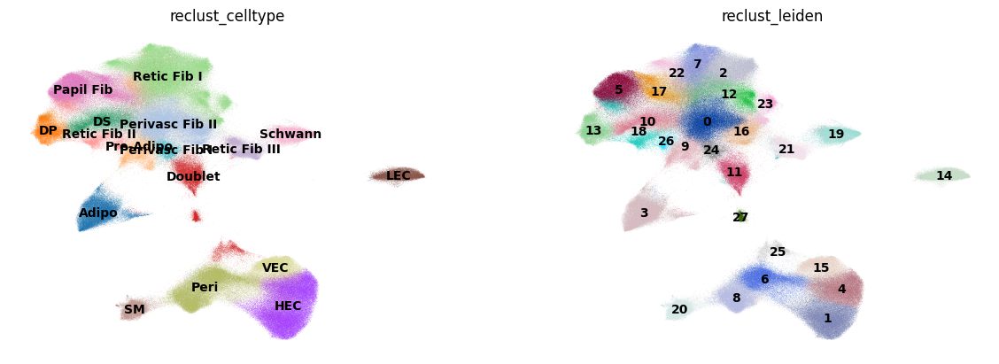

In [11]:
sc.pl.embedding(adata, basis='reclust_harmony_umap', color=['reclust_celltype', 'reclust_leiden'], legend_loc='on data', frameon=False)

In [12]:
adata.obs['cell_type.detailed'] = adata.obs['reclust_celltype'].copy()

In [21]:
import gc
gc.collect()

69452

In [13]:
adata.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')

In [ ]:
adata.obs.to_csv(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.cell_metadata.csv')

## Fibroblast

In [9]:
adata = sc.read_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{reclust_category}.reclustered.baysor.scvi_integrated.anndata.h5ad')

In [90]:
recluster_subcategory = "Fibroblast"

adata_sub = adata[[x in ['Papil Fib', 'Perivasc Fib I', "Perivasc Fib II", "Retic Fib I", "Retic Fib II", 'Retic Fib III', 'DP', 'DS', 'Pre-Adipo'] for x in adata.obs["reclust_celltype"]]].copy()
gc.collect()

adata_sub = sc.AnnData(X=adata_sub.layers['counts'], obs=adata_sub.obs, var=adata_sub.var)
adata_sub.layers['counts'] = adata_sub.X.copy()
sc.pp.normalize_total(adata_sub)
sc.pp.log1p(adata_sub)
adata_sub.layers['log1p'] = adata_sub.X.copy()
sc.pp.highly_variable_genes(adata_sub, n_top_genes=500, batch_key = 'batch', subset=False)
sc.pp.scale(adata_sub, max_value=10)
adata_sub.layers['scaled'] = adata_sub.X.copy()
adata_sub_filt = adata_sub[:, adata_sub.var['highly_variable']&adata_sub.var['in_both_panels']].copy()
gc.collect()
scvi.model.SCVI.setup_anndata(adata_sub_filt, layer="counts", batch_key="sample_barcode",
                               continuous_covariate_keys=["transcript_count"], 
                               categorical_covariate_keys=['donor_id', 'collection_source'])
train_kwargs = {"train_size": 1.0}
model = scvi.model.SCVI(adata_sub_filt, n_layers=2, n_latent=30, gene_likelihood="nb")
model.train(accelerator='gpu', **train_kwargs)
model.save(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}_scvi_model', overwrite=True)
del adata_sub_filt 
gc.collect()

adata_sub.obsm[f'reclust_scvi'] = model.get_latent_representation()
sc.pp.neighbors(adata_sub, use_rep = f'reclust_scvi', n_pcs=30, n_neighbors=30, random_state=12345)
sc.tl.umap(adata_sub, min_dist=0.1, negative_sample_rate=10, key_added=f'reclust_scvi_umap', random_state=12345)

resolutions = [0.2, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 2.5]
for res in resolutions:
    sc.tl.leiden(adata_sub, resolution = res, key_added=f'reclust.scvi.leiden_{res}', random_state=12345)
    print(adata_sub.obs[f'reclust.scvi.leiden_{res}'].value_counts())
adata_sub.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')
adata_sub.obs.to_csv(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}.reclustered.baysor.scvi_integrated.cell_metadata.csv')

import scanpy.external as sce
sc.tl.pca(adata_sub, n_comps=30, mask_var='in_both_panels', key_added='pca')
sce.pp.harmony_integrate(adata_sub, key='sample_barcode', basis='pca', adjusted_basis='reclust_harmony')
sc.pp.neighbors(adata_sub, use_rep = f'reclust_harmony', n_pcs=30, n_neighbors=30, random_state=12345)
sc.tl.umap(adata_sub, min_dist=0.1, negative_sample_rate=10, key_added=f'reclust_harmony_umap', random_state=12345)

resolutions = [0.2, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 2.5]
for res in resolutions:
    sc.tl.leiden(adata_sub, resolution = res, key_added=f'reclust.harmony.leiden_{res}', random_state=12345)
    print(adata_sub.obs[f'reclust.harmony.leiden_{res}'].value_counts())
adata_sub.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}.reclustered.baysor.scvi_integrated.anndata.h5ad', compression='gzip')
adata_sub.obs.to_csv(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}.reclustered.baysor.scvi_integrated.cell_metadata.csv')

c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scvi\model\_scvi.py:159: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  library_log_means, library_log_vars = _init_library_size(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Epoch 25/25: 100%|██████████| 25/25 [07:59<00:00, 20.82s/it, v_num=1, train_loss_step=63.6, train_loss_epoch=62.9]

`Trainer.fit` stopped: `max_epochs=25` reached.


Epoch 25/25: 100%|██████████| 25/25 [07:59<00:00, 19.19s/it, v_num=1, train_loss_step=63.6, train_loss_epoch=62.9]


C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4236365178.py:32: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_sub, resolution = res, key_added=f'reclust.scvi.leiden_{res}', random_state=12345)


reclust.scvi.leiden_0.2
0    322838
Name: count, dtype: int64
reclust.scvi.leiden_0.4
0    157275
1     88336
2     69572
3      7655
Name: count, dtype: int64
reclust.scvi.leiden_0.5
0    94891
1    52992
2    51460
3    50230
4    39882
5    25188
6     8195
Name: count, dtype: int64
reclust.scvi.leiden_0.6
0    80514
1    56814
2    51341
3    50091
4    41703
5    32884
6     9491
Name: count, dtype: int64
reclust.scvi.leiden_0.8
0    58523
1    53199
2    48154
3    44869
4    37192
5    35397
6    30095
7    15409
Name: count, dtype: int64
reclust.scvi.leiden_1
0     57220
1     47147
2     40791
3     40696
4     37906
5     37469
6     31124
7     16843
8     13471
9       149
10       22
Name: count, dtype: int64
reclust.scvi.leiden_1.5
0     31581
1     30499
2     28750
3     28045
4     27802
5     26318
6     22730
7     22224
8     19628
9     18172
10    17141
11    17097
12    14601
13    14202
14     2481
15      934
16      633
Name: count, dtype: int64
reclust.scvi.l

2025-04-22 15:27:35,792 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-22 15:27:52,826 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-22 15:27:54,389 - harmonypy - INFO - Iteration 1 of 10
2025-04-22 15:30:22,858 - harmonypy - INFO - Iteration 2 of 10
2025-04-22 15:32:53,137 - harmonypy - INFO - Converged after 2 iterations


reclust.harmony.leiden_0.2
0    314094
1      8744
Name: count, dtype: int64
reclust.harmony.leiden_0.4
0    89385
1    77173
2    49326
3    39248
4    31518
5    23985
6    12203
Name: count, dtype: int64
reclust.harmony.leiden_0.5
0    79508
1    59528
2    45240
3    35478
4    28152
5    27253
6    25692
7    12774
8     9213
Name: count, dtype: int64
reclust.harmony.leiden_0.6
0     67704
1     50478
2     40150
3     29589
4     26795
5     26321
6     21473
7     21465
8     14188
9     10318
10     9326
11     5031
Name: count, dtype: int64
reclust.harmony.leiden_0.8
0     51248
1     46136
2     36306
3     25847
4     23004
5     19896
6     19410
7     15941
8     14736
9     12810
10    11904
11    11308
12    10929
13     9390
14     5925
15     4831
16     3217
Name: count, dtype: int64
reclust.harmony.leiden_1
0     37756
1     35102
2     33333
3     29722
4     25127
5     22754
6     21068
7     19097
8     17832
9     15601
10    15375
11    13260
12    11242
13    

In [98]:
fib = adata_sub.copy()
del adata_sub
gc.collect()

NameError: name 'adata_sub' is not defined

### Main Fib Plots

In [8]:
recluster_subcategory = "Fibroblast"
fib = sc.read_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}.reclustered.baysor.scvi_integrated.anndata.h5ad')

In [92]:
recluster_subcategory='Fibroblast'
resolutions = [0.2, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 2.5]
res_cols = [f'reclust.harmony.leiden_{res}' for res in resolutions]

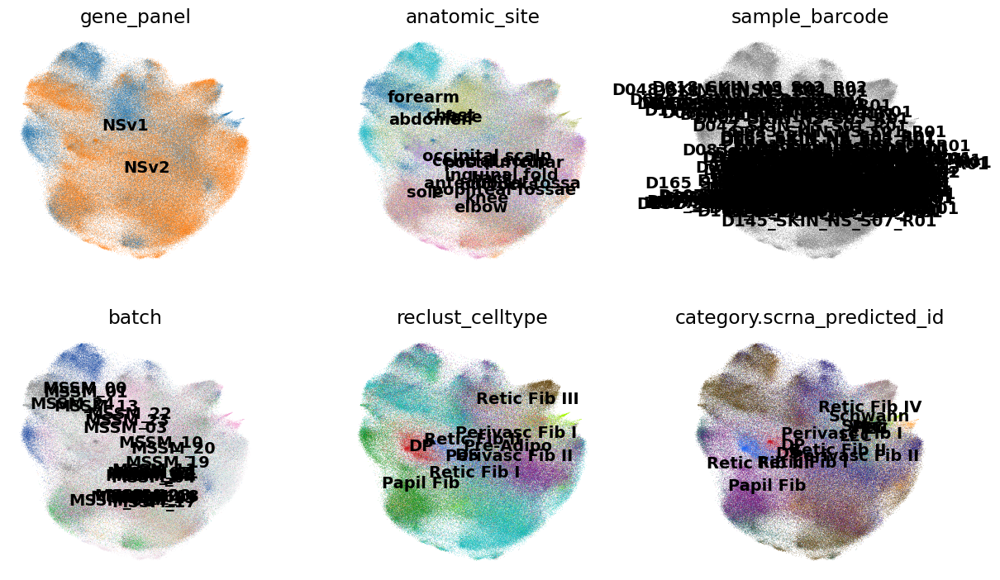

In [179]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(fib, basis=f'reclust_scvi_umap', 
                    color=['gene_panel', 'anatomic_site', 'sample_barcode', 'batch', 'reclust_celltype', 'category.scrna_predicted_id'],
                     frameon=False, ncols=3, legend_loc='on data')

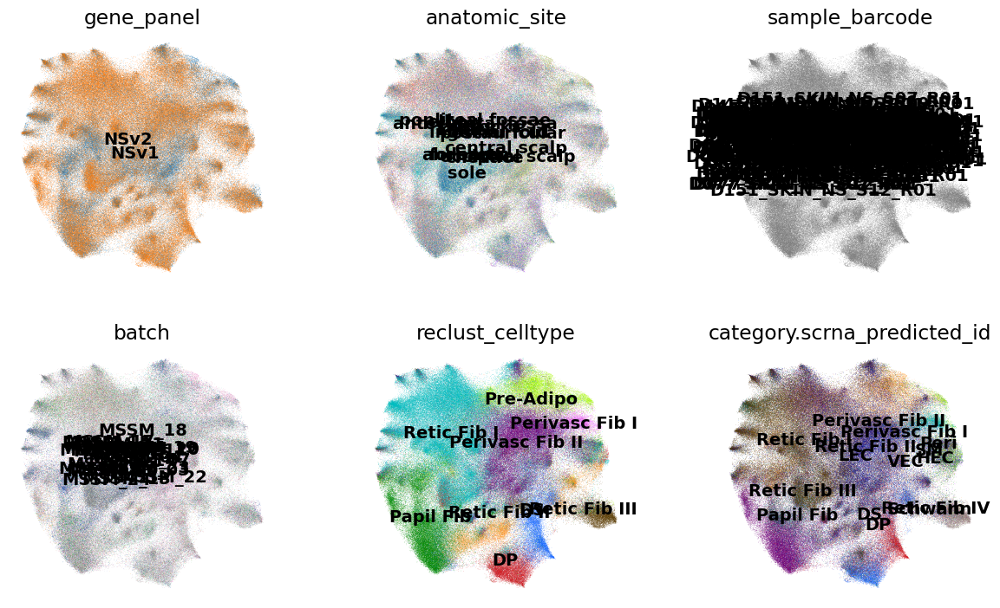

In [99]:
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(fib, basis=f'reclust_harmony_umap', 
                    color=['gene_panel', 'anatomic_site', 'sample_barcode', 'batch', 'reclust_celltype', 'category.scrna_predicted_id'],
                     frameon=False, ncols=3, legend_loc='on data')

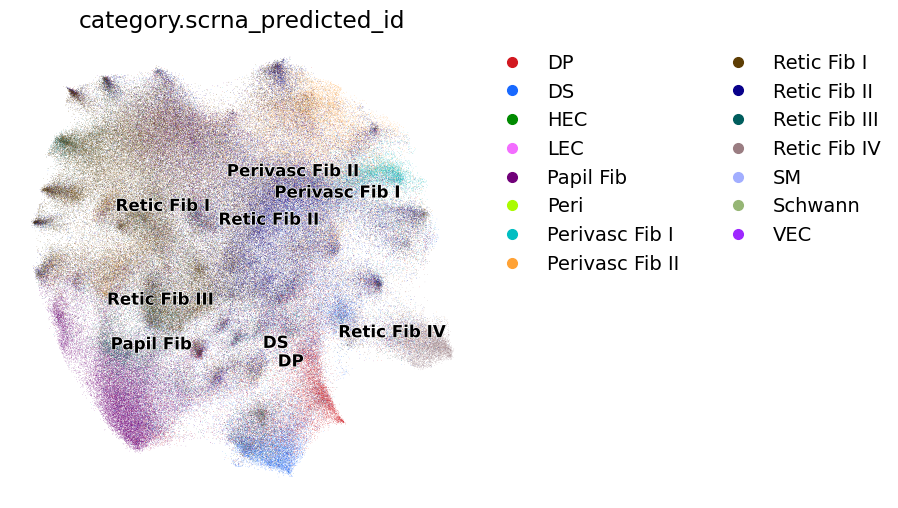

In [100]:
from matplotlib.lines import Line2D

with rc_context({"figure.figsize": (6, 6), "font.size": 14, "image.aspect": 1}):
    fig = sc.pl.embedding(fib, basis=f'reclust_harmony_umap', color=['category.scrna_predicted_id'],
                          groups=['Papil Fib', 'Perivasc Fib I', 'Perivasc Fib II', "Retic Fib I", "Retic Fib II", "Retic Fib III", "Retic Fib IV", "DP", "DS"], 
                          frameon=False, legend_loc='on data', legend_fontoutline=1, legend_fontsize=12, 
                          na_in_legend=False, palette=glasbey.create_palette(15), na_color='white',
                          return_fig=True, show=False)
    ax = fig.axes[0]
    l1 = ax.legend(
    # Add Legend element for each color group
    handles=[
        # Instead of Line2D we can also use other matplotlib objects, such as Patch, etc.
        Line2D([0], [0], marker="o", color=c, lw=0, label=l, markerfacecolor=c, markersize=7)
        # Color groups in adata
        for l, c in zip(
            list(adata.obs['category.scrna_predicted_id'].cat.categories), glasbey.create_palette(15)
        )
    ],
    # Customize Legend outline
    # Remove background
    frameon=False,
    # Make more Legend columns
    ncols=2,
    # Change location to not overlap with the plot
    bbox_to_anchor=(1, 1),
    # Set title
    title=''
    )
    plt.show()

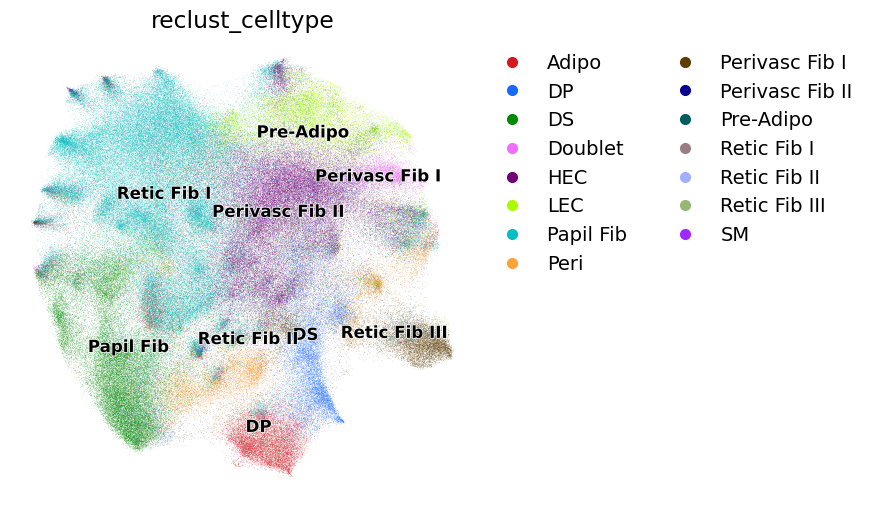

In [121]:
from matplotlib.lines import Line2D

with rc_context({"figure.figsize": (6, 6), "font.size": 14, "image.aspect": 1}):
    fig = sc.pl.embedding(fib, basis=f'reclust_harmony_umap', color=['reclust_celltype'],
                          frameon=False, legend_loc='on data', legend_fontoutline=1, legend_fontsize=12, 
                          na_in_legend=False, palette=glasbey.create_palette(15), na_color='white',
                          return_fig=True, show=False)
    ax = fig.axes[0]
    l1 = ax.legend(
    # Add Legend element for each color group
    handles=[
        # Instead of Line2D we can also use other matplotlib objects, such as Patch, etc.
        Line2D([0], [0], marker="o", color=c, lw=0, label=l, markerfacecolor=c, markersize=7)
        # Color groups in adata
        for l, c in zip(
            list(adata.obs['reclust_celltype'].cat.categories), glasbey.create_palette(15)
        )
    ],
    # Customize Legend outline
    # Remove background
    frameon=False,
    # Make more Legend columns
    ncols=2,
    # Change location to not overlap with the plot
    bbox_to_anchor=(1, 1),
    # Set title
    title=''
    )
    plt.show()

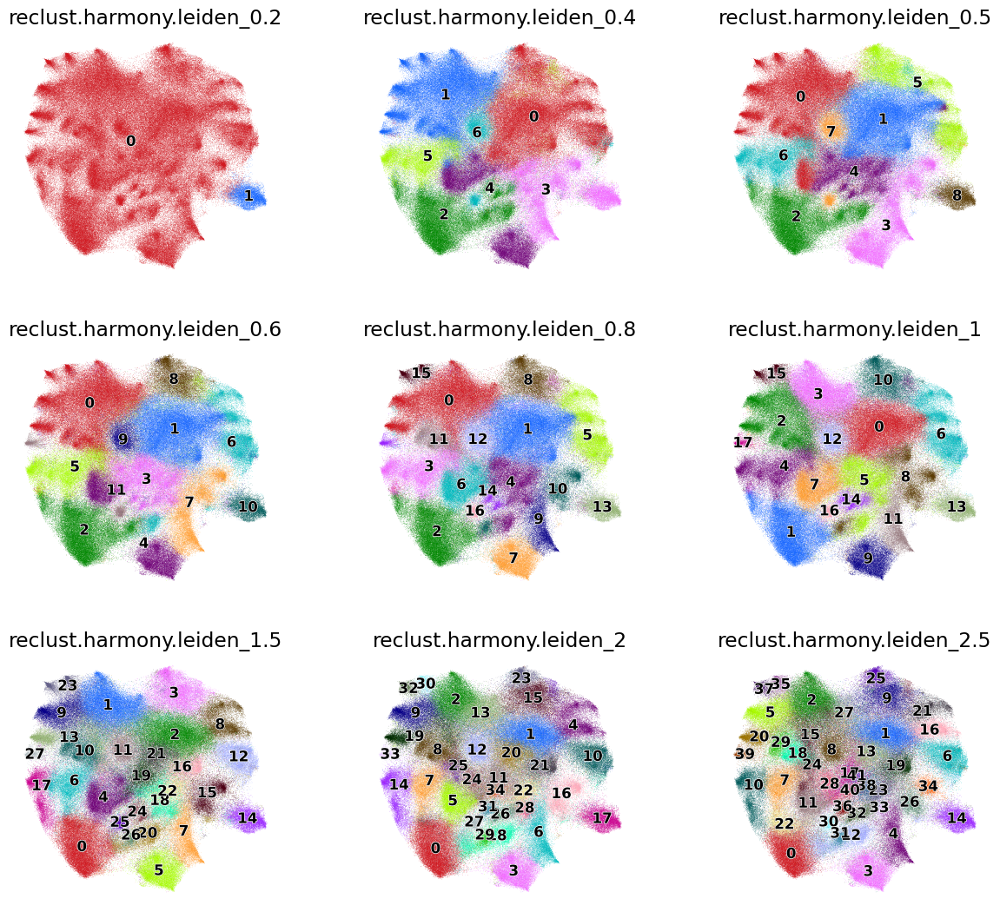

In [106]:
res_cols = [f'reclust.harmony.leiden_{res}' for res in resolutions]
with rc_context({"figure.figsize": (4, 4), "font.size": 14, "image.aspect": 1}):
    sc.pl.embedding(fib, basis=f'reclust_harmony_umap', color=res_cols, frameon=False, ncols=3, 
                    legend_loc='on data', palette=glasbey.create_palette(40), legend_fontoutline=1, legend_fontsize=12)

### Density Plots

In [108]:
fib.obsm['X_umap'] = fib.obsm[f'reclust_harmony_umap']
sc.tl.embedding_density(fib, basis='umap', key_added='umap_density.category.scrna_predicted_id', groupby='category.scrna_predicted_id')
sc.tl.embedding_density(fib, basis='umap', key_added='umap_density.anatomic_site', groupby='anatomic_site')

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\786311459.py:5: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


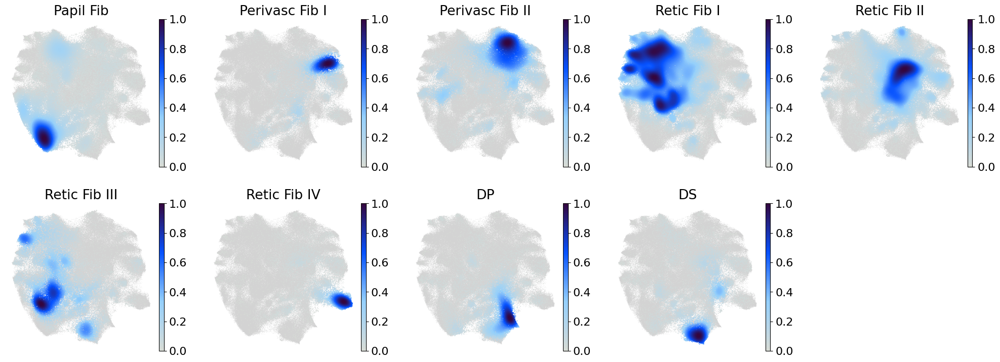

In [109]:
groups2plot=['Papil Fib', "Perivasc Fib I", "Perivasc Fib II", "Retic Fib I", "Retic Fib II", "Retic Fib III", 'Retic Fib IV', 'DP', "DS"]
with rc_context({"figure.figsize": (4, 4), "font.size": 16, "image.aspect": 1}):
    sc.pl.embedding_density(fib, basis='umap', key='umap_density.category.scrna_predicted_id', color_map = GrBuPu, 
                            bg_dotsize=1, fg_dotsize=5, ncols=5, group=groups2plot, frameon=False, show=False)
    plt.tight_layout()
    plt.show()
    plt.close()

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\2335852264.py:3: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


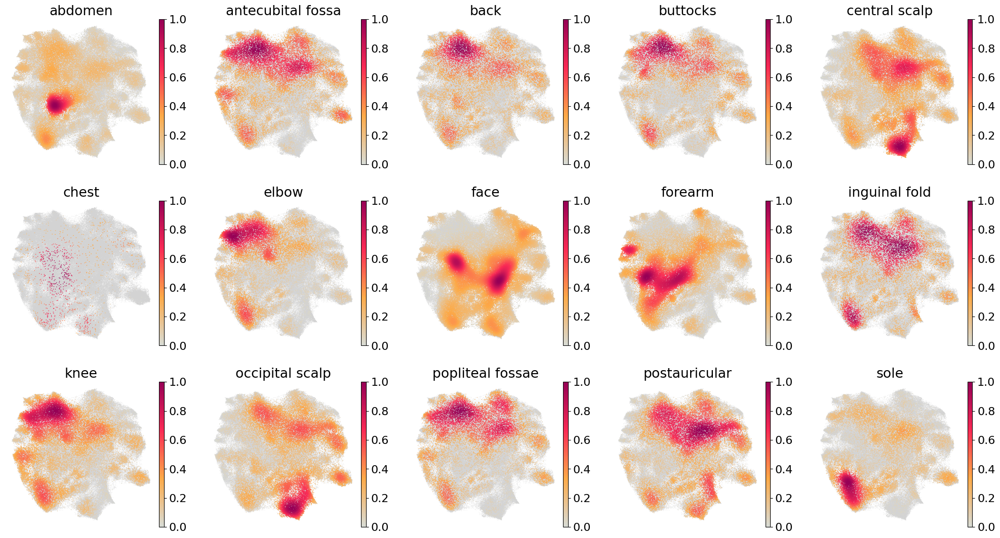

In [110]:
with rc_context({"figure.figsize": (4, 4), "font.size": 16, "image.aspect": 1}):
    sc.pl.embedding_density(fib, basis='umap', key='umap_density.anatomic_site', color_map=GrSunSet, bg_dotsize=1, fg_dotsize=5, ncols=5, frameon=False, show=False)
    plt.tight_layout()
    plt.show()
    plt.close()

### Marker Dotplots

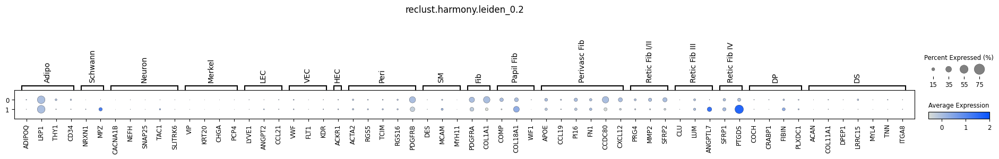

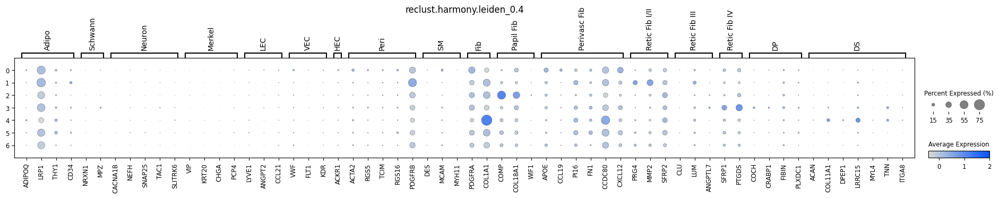

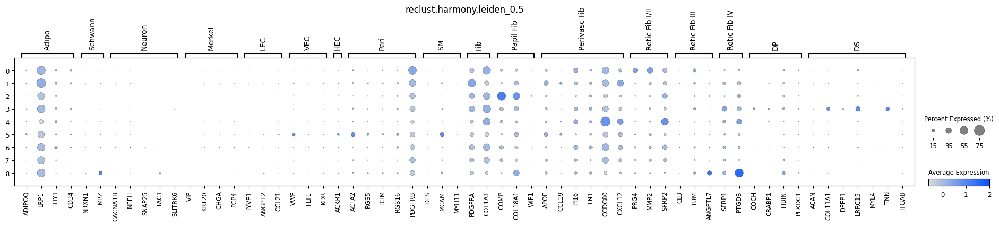

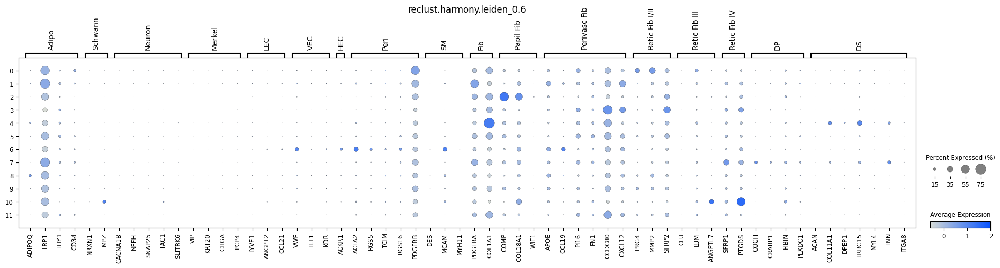

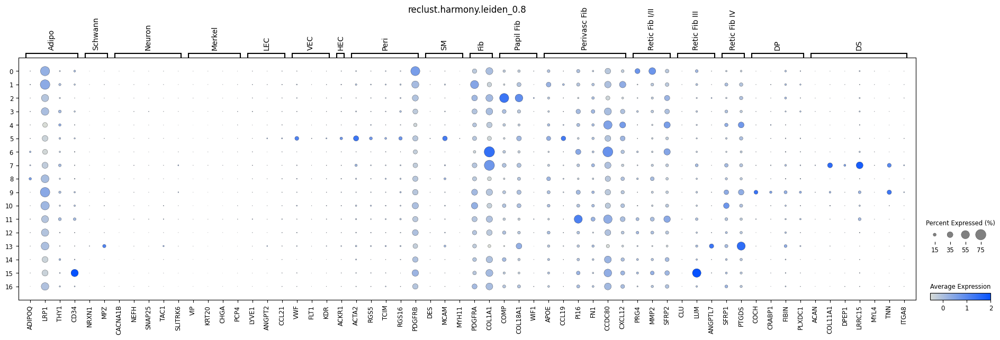

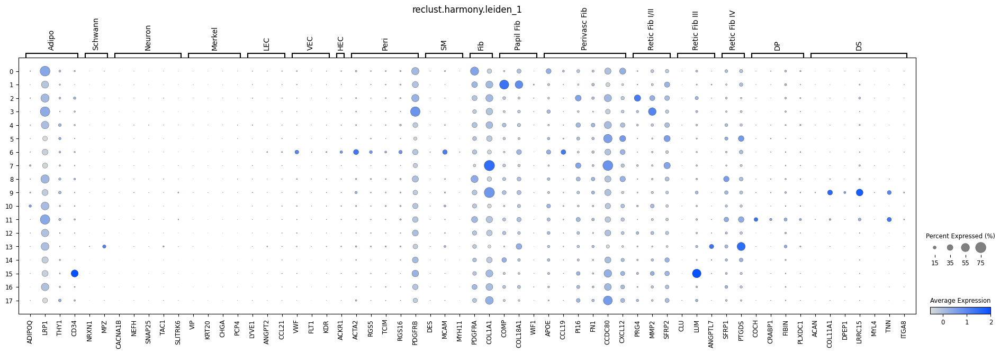

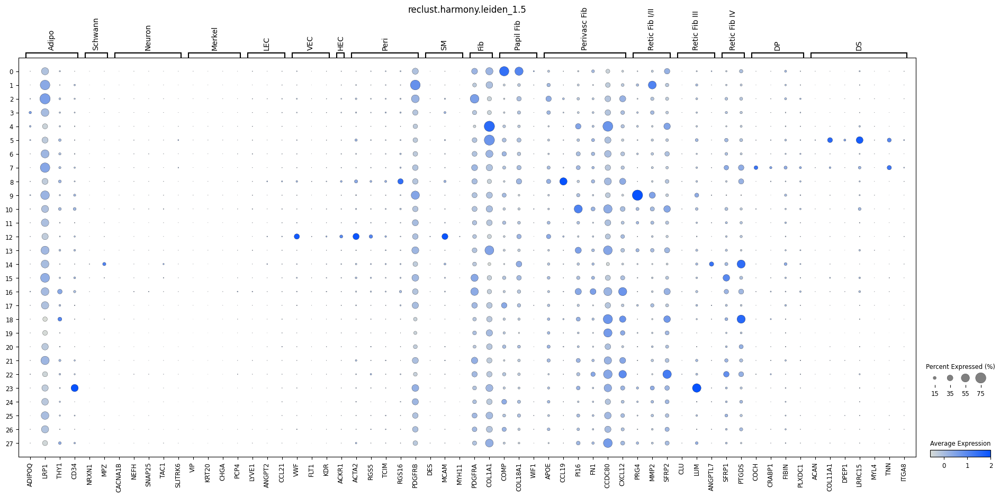

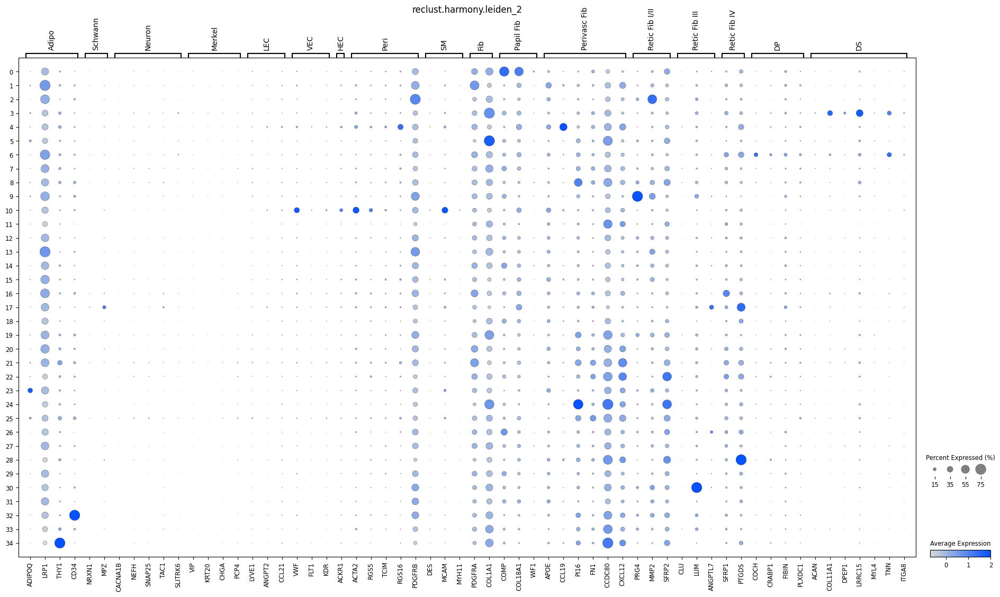

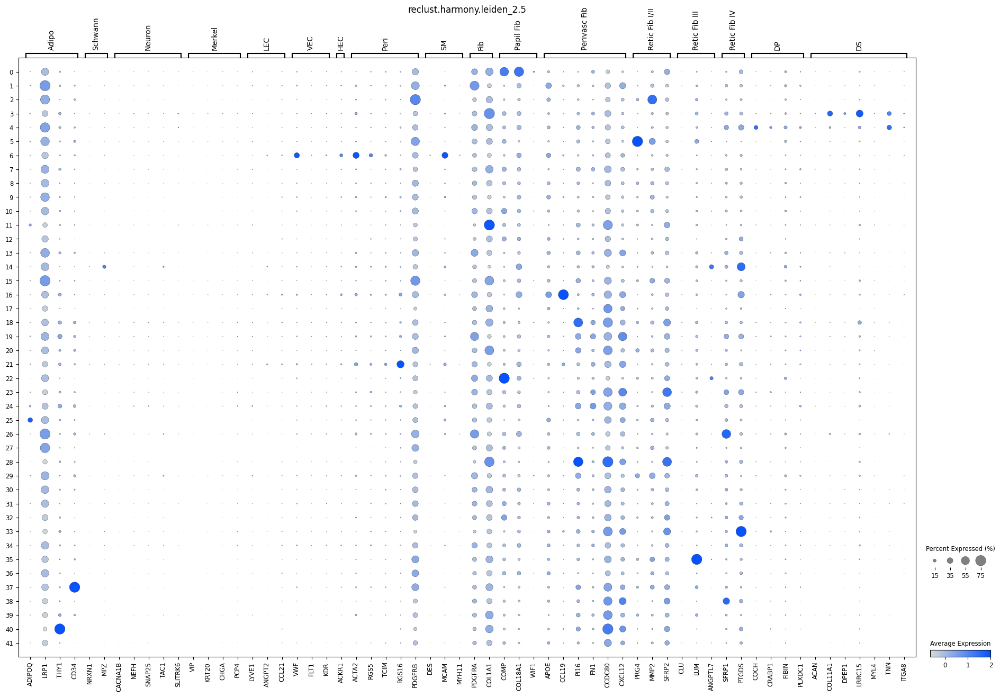

In [144]:
for res_col in res_cols:
    with plt.rc_context(): 
        sc.pl.dotplot(
            fib, stroma_markers, groupby=res_col, dendrogram=False, cmap=gray2blue, show=False, 
            dot_min=0, dot_max=0.75, vmax=2,
            title=res_col, colorbar_title='Average Expression', size_title='Percent Expressed (%)'
        )
        # Save the figure
        plt.savefig(f'D:/Dropbox/_projects/NormalSkinAtlas/figures/merfish/BAYSOR/reclustering/{reclust_category}/dot_plots/{recluster_subcategory}.{res_col}.stroma_markers.dotplot.png', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

### Feature UMAPs

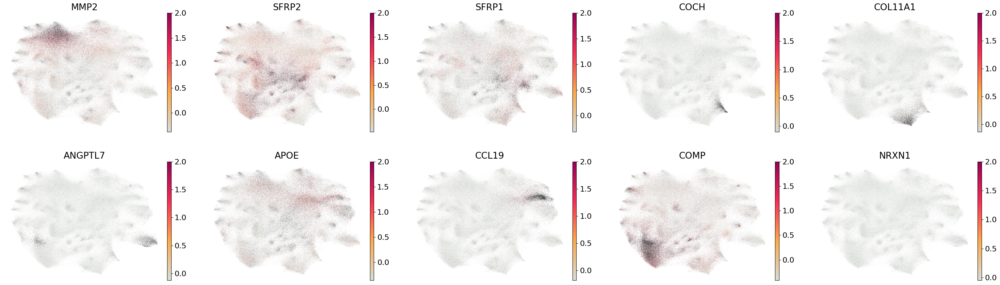

In [180]:
with plt.rc_context({"font.size": 16}): 
    sc.pl.embedding(fib, basis=f'reclust_harmony_umap',
                     color=['MMP2', 'SFRP2', "SFRP1", 'COCH', 'COL11A1', 'ANGPTL7', 'APOE', 'CCL19', 'COMP', 'NRXN1'],
                     ncols=5, cmap=GrSunSet, frameon=False, show=False,
                     vmax=2)
    plt.show()
    plt.close()

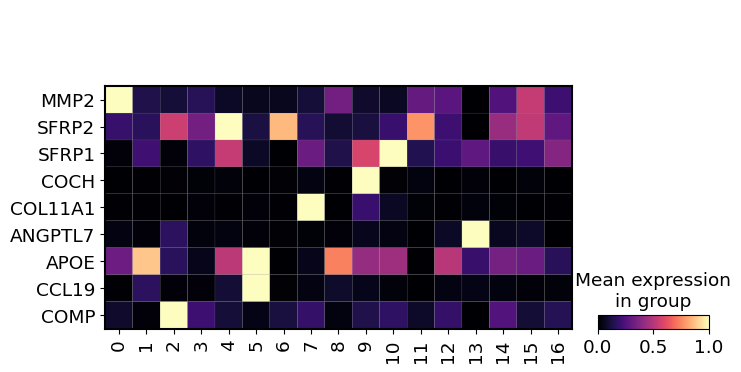

In [181]:
with plt.rc_context({"font.size": 16}): 
    sc.pl.matrixplot(fib, 
                     var_names=['MMP2', 'SFRP2', "SFRP1", 'COCH', 'COL11A1', 'ANGPTL7', 
                                'APOE', 'CCL19', 'COMP'], standard_scale='var',
                     groupby='reclust.harmony.leiden_0.8', cmap='magma', show=False, swap_axes=True)
    plt.show()
    plt.close()

In [174]:
fib.obs['is_sole'] = [x == 'sole' for x in fib.obs['anatomic_site']]
cross_tab = pd.crosstab(fib.obs['is_sole'], fib.obs['reclust.harmony.leiden_1.5'], normalize='columns')


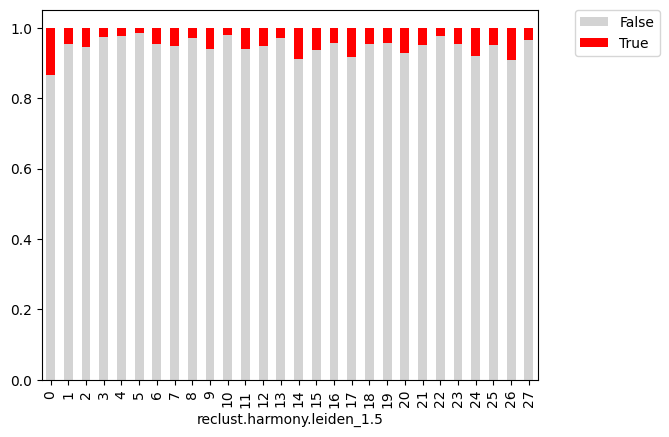

In [176]:
cross_tab.T.plot(
    kind='bar',
    stacked=True, color=["lightgrey", 'red']
).legend(loc='upper right', bbox_to_anchor=(1.26, 1.02))
plt.show()
plt.close()

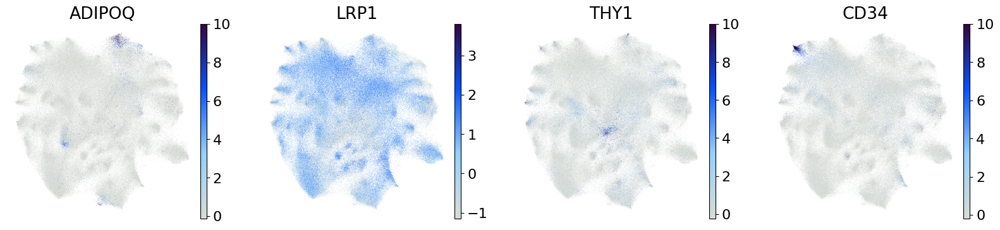

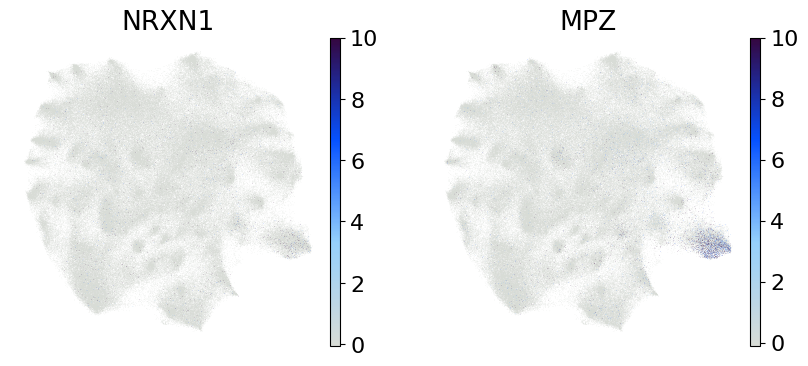

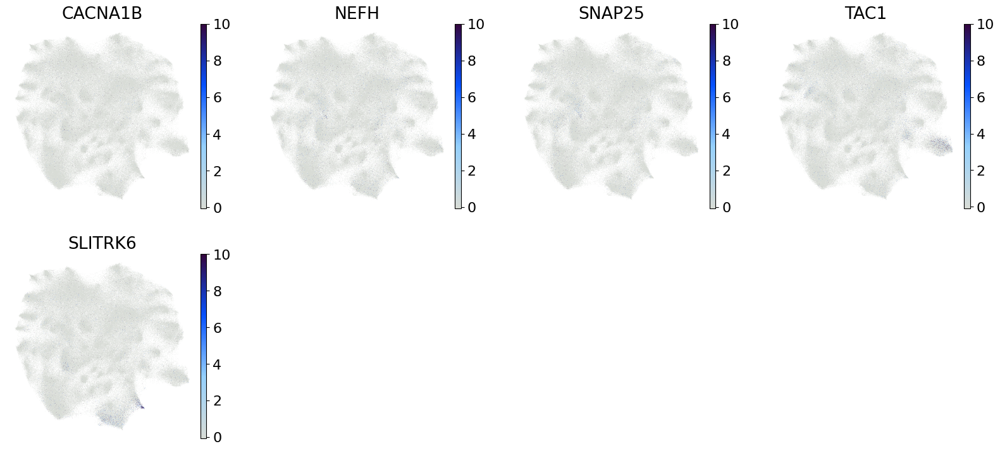

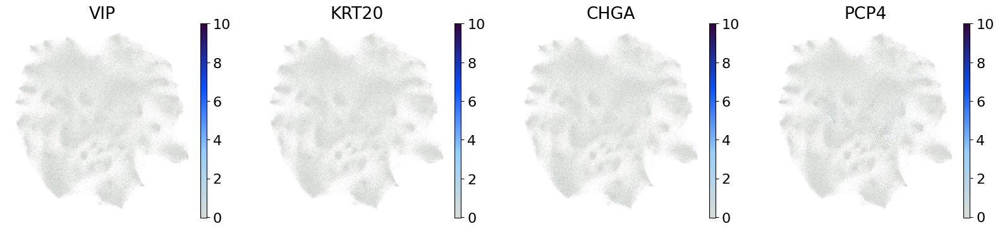

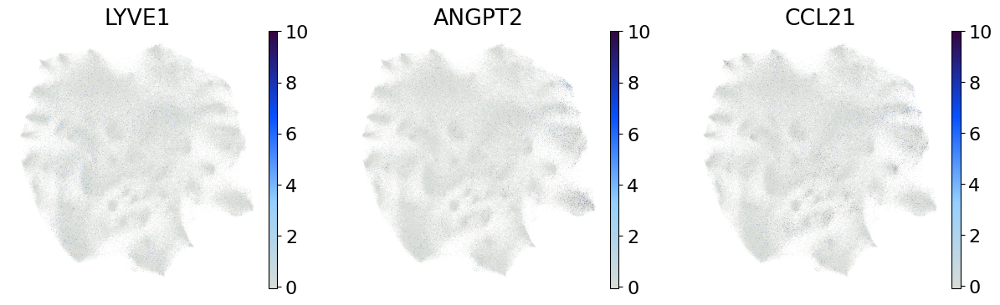

...

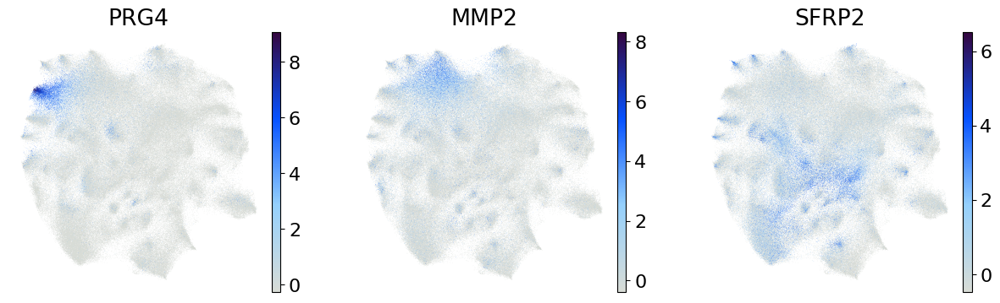

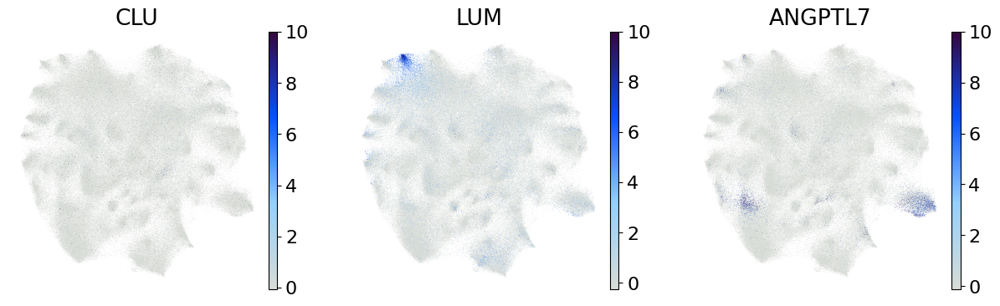

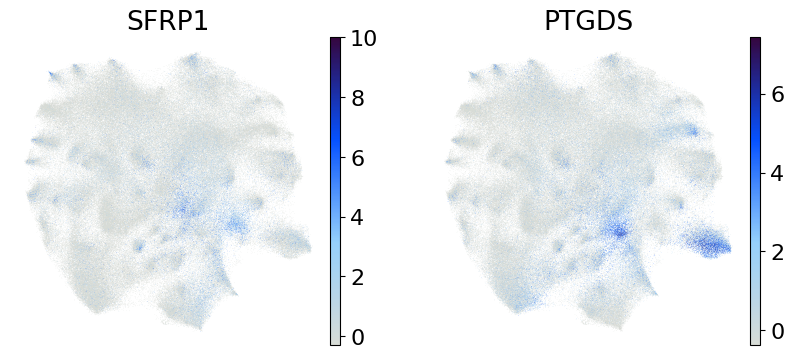

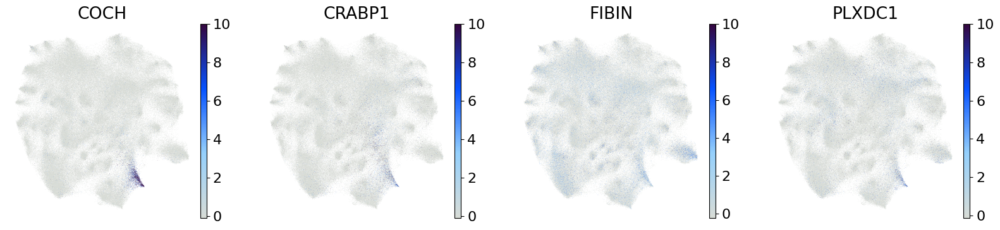

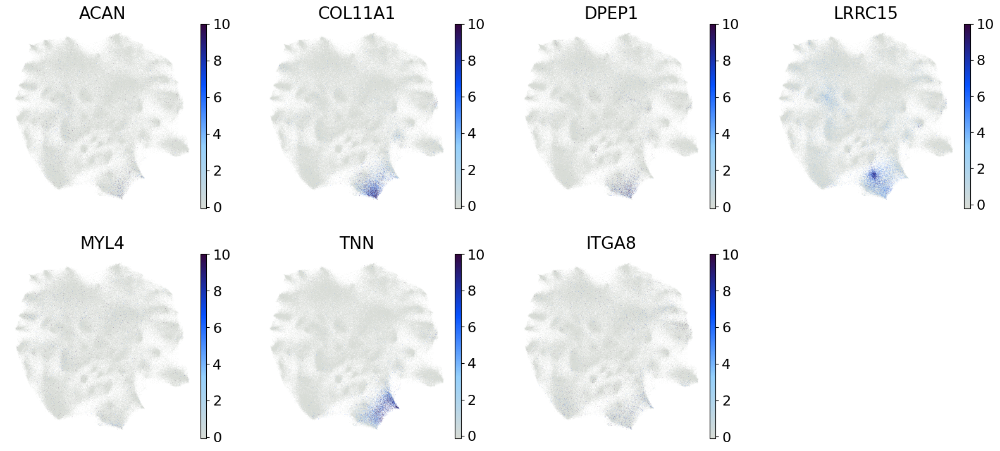

In [113]:
for cell_type in stroma_markers.keys():
    with plt.rc_context({"figure.figsize": (4, 4), "font.size": 16, "image.aspect": 1}): 
        sc.pl.embedding(fib, basis=f'reclust_harmony_umap', color=stroma_markers[cell_type], cmap=GrBuPu, frameon=False, show=False)
        cell_type = cell_type.replace(" ", "_").replace("+", "_pos").replace("-", "_").replace("/", "_")
        plt.savefig(f'D:/Dropbox/_projects/NormalSkinAtlas/figures/merfish/BAYSOR/reclustering/{reclust_category}/feature_umap/{recluster_subcategory}.{cell_type}.markers.harmony.feature_umap.png', dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

### Spatial Highlights

### Get Cluster Markers

In [114]:
fib_cluster_markers = calculate_cluster_markers(fib, prefix=recluster_subcategory, res_cols=res_cols, data_path='../../data/merfish/BAYSOR/reclustering/Stroma/Fibroblast')

Processing resolution: reclust.harmony.leiden_0.2
Finished processing resolution: reclust.harmony.leiden_0.2
Processing resolution: reclust.harmony.leiden_0.4
Finished processing resolution: reclust.harmony.leiden_0.4
Processing resolution: reclust.harmony.leiden_0.5
Finished processing resolution: reclust.harmony.leiden_0.5
Processing resolution: reclust.harmony.leiden_0.6
Finished processing resolution: reclust.harmony.leiden_0.6
Processing resolution: reclust.harmony.leiden_0.8
Finished processing resolution: reclust.harmony.leiden_0.8
Processing resolution: reclust.harmony.leiden_1
Finished processing resolution: reclust.harmony.leiden_1
Processing resolution: reclust.harmony.leiden_1.5


c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:440: PerformanceWarning: DataFrame i

Finished processing resolution: reclust.harmony.leiden_1.5
Processing resolution: reclust.harmony.leiden_2


c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:440: PerformanceWarning: DataFrame i

Finished processing resolution: reclust.harmony.leiden_2
Processing resolution: reclust.harmony.leiden_2.5


c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\Paula\miniconda3\envs\rapids\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:440: PerformanceWarning: DataFrame i

Finished processing resolution: reclust.harmony.leiden_2.5


Cluster Marker Dotplots

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


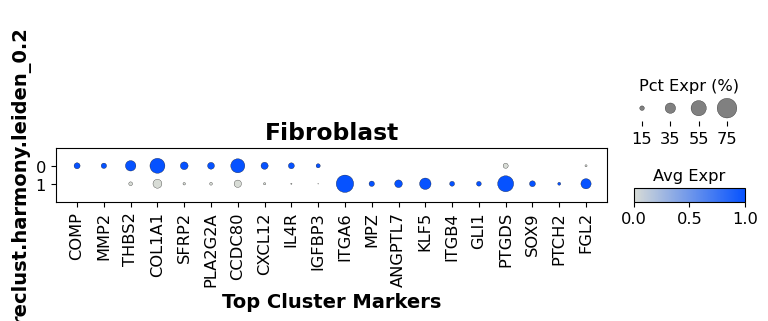

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


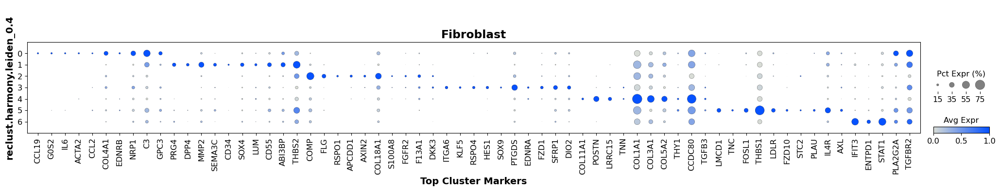

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


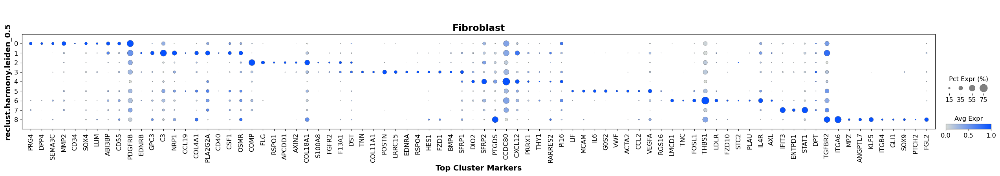

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


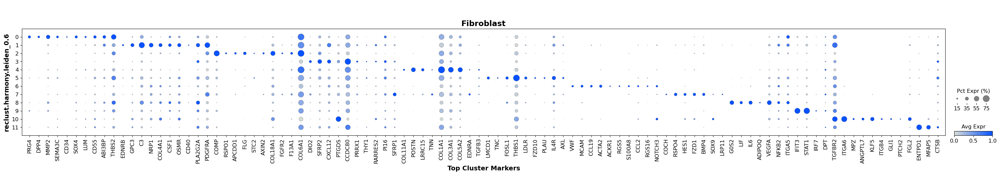

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


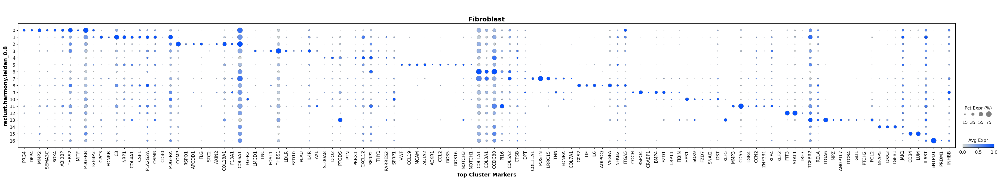

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


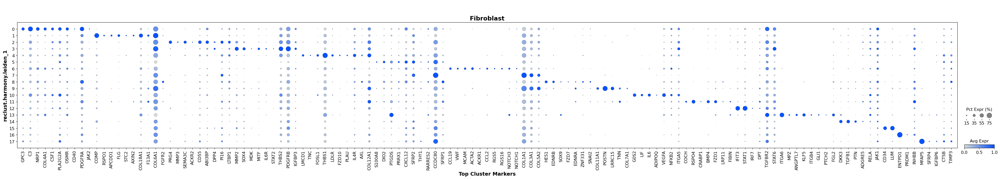

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


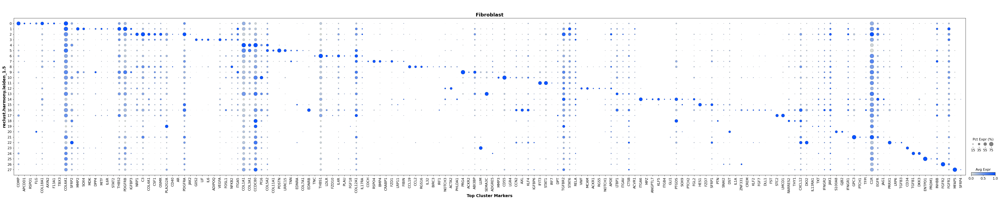

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


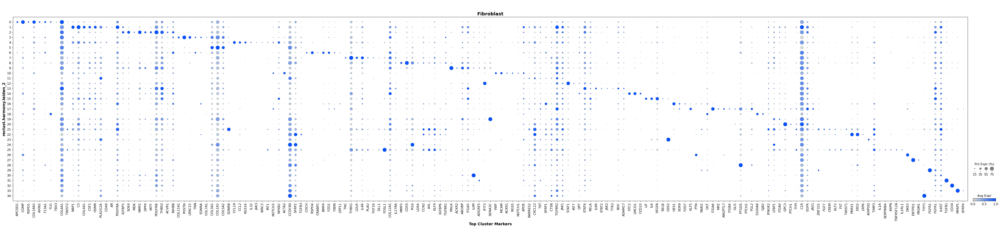

C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_markers['cluster'] = top_markers['cluster'].astype('int64')
C:\Users\Paula\AppData\Local\Temp\ipykernel_28896\4159266737.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)


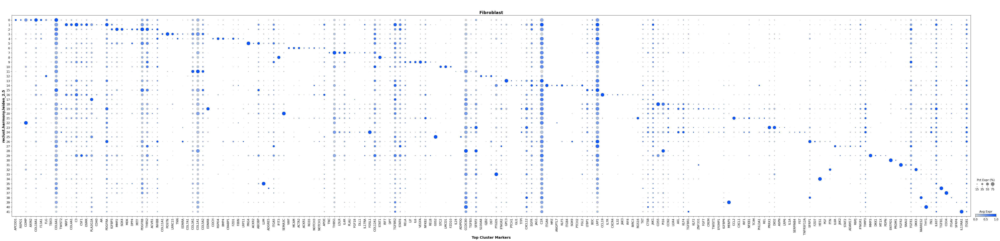

In [115]:
for res in res_cols:
    top_markers = fib_cluster_markers[res][fib_cluster_markers[res]["is_signif"]&fib_cluster_markers[res]["is_positive"]]
    if len(top_markers)>1:
        top_markers['cluster'] = top_markers['cluster'].astype('int64')
        top_markers = top_markers.groupby('cluster').apply(lambda x: x[x['is_signif']&(x['log2fc']>0.2)&(x['pct_cluster']>0.1)].nlargest(10, 'log2fc')['gene'].values)
        top_markers = top_markers.explode().dropna().unique().tolist()
        with plt.rc_context({"font.size": 14}): 
            dp = sc.pl.dotplot(fib, var_names = top_markers,
                          groupby=res, dendrogram=False,
                          cmap=gray2blue, show=False,
                          standard_scale='var', layer='log1p',
                          dot_min=0.05, dot_max=0.75,
                          colorbar_title='Avg Expr', 
                          size_title='Pct Expr (%)')
            ax = dp['mainplot_ax']
            ax.set_xlabel('Top Cluster Markers', fontweight='bold')
            ax.set_ylabel(res, fontweight='bold')
            ax.set_title(f'{recluster_subcategory}', fontweight='bold')
            # Save the figure
            plt.savefig(f'D:/Dropbox/_projects/NormalSkinAtlas/figures/merfish/BAYSOR/reclustering/{recluster_subcategory}/dot_plots/{recluster_subcategory}.{res}.scanpy.cluster_markers.dotplot.png', dpi=300, bbox_inches='tight')
            plt.show()
            plt.close()
    else:
        "No markers found for this resolution"

In [ ]:
gc.collect()

### Annotate Fibroblasts

In [ ]:
recluster_subcategory = "Fibroblast"

In [189]:
chosen_res = 0.8
res = f'reclust.harmony.leiden_{chosen_res}'
fib.obs['reclust_leiden'] = fib.obs[res]
df = {
    'reclust_leiden' : fib.obs[res].values.categories,
    'reclust_celltype' :  ["Retic Fib I", "Perivasc Fib II", "Papil Fib II", "Papil Fib I", "Perivasc Fib II",
                           "Perivasc Fib I", "Papil Fib I", "DS", "Pre-Adipo", "DP", "Perivasc Fib II", "Papil Fib I", 
                           "Perivasc Fib II", "Retic Fib II", "Perivasc Fib II", "Retic Fib I", "Papil Fib I"]}

df = pd.DataFrame(df)
cluster_to_cell_type = df.set_index('reclust_leiden')["reclust_celltype"].to_dict()
fib.obs["reclust_celltype"] = fib.obs['reclust_leiden'].map(cluster_to_cell_type)

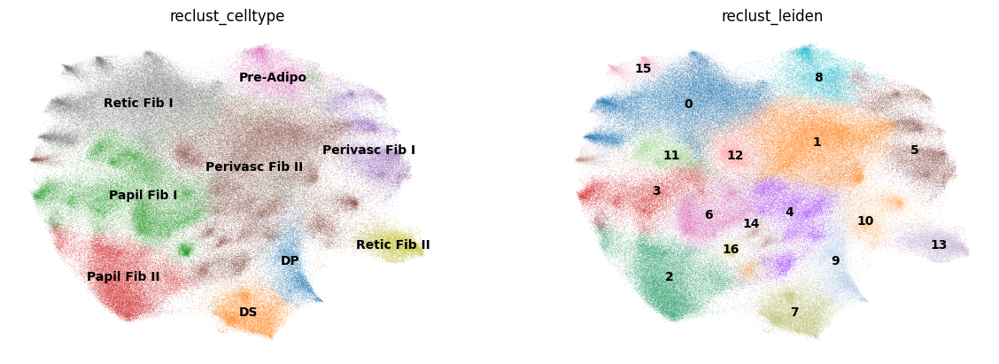

In [190]:
sc.pl.embedding(fib, basis=f'reclust_harmony_umap', color=['reclust_celltype', 'reclust_leiden'], legend_loc='on data', frameon=False)

In [191]:
fib.write_h5ad(f'../../data/merfish/BAYSOR/reclustering/{reclust_category}/{recluster_subcategory}/{recluster_subcategory}.reclustered.baysor.scvi_integrated.anndata.h5ad')

KeyboardInterrupt: 

In [192]:
with plt.rc_context(): 
        sc.pl.dotplot(
            fib, stroma_markers, groupby='reclust_celltype', dendrogram=False, cmap=gray2blue, show=False, 
            dot_min=0, dot_max=0.75, vmax=2,
            title=res_col, colorbar_title='Average Expression', size_title='Percent Expressed (%)'
        )